In [1]:
# IMPORTS #
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_style('darkgrid')
from sklearn.preprocessing import LabelEncoder, PolynomialFeatures
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, GridSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.metrics import mean_squared_error
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor, ExtraTreesRegressor
from pandas_profiling import ProfileReport
from sklearn.pipeline import make_pipeline
import xgboost as xgb
import pickle
import os

C:\Users\sdman\Anaconda3\lib\site-packages\dask\dataframe\utils.py:14: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Data import/Manipulation 

In [2]:
# from kaggle this is a dataset of MyAnimeList.net of popular anime

# exporting csv file to a DataFrame only using columns listed
df = pd.read_csv("data/anime_cleaned.csv", usecols=['title','type','source','episodes','rating', 'score', 'scored_by','rank','popularity','members', 'favorites','duration_min','aired_from_year'])
df_number_set = pd.read_csv("data/anime_cleaned.csv", usecols=['episodes', 'score', 'scored_by','rank','popularity','members', 'favorites','duration_min','aired_from_year'])
display(df)
display(df_number_set)

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,TV,Manga,12,PG-13 - Teens 13 or older,7.63,139250,1274.0,231,283882,2809,24.0,2012.0
1,Seto no Hanayome,TV,Manga,26,PG-13 - Teens 13 or older,7.89,91206,727.0,366,204003,2579,24.0,2007.0
2,Shugo Chara!! Doki,TV,Manga,51,PG - Children,7.55,37129,1508.0,1173,70127,802,24.0,2008.0
3,Princess Tutu,TV,Original,38,PG-13 - Teens 13 or older,8.21,36501,307.0,916,93312,3344,16.0,2002.0
4,Bakuman. 3rd Season,TV,Manga,25,PG-13 - Teens 13 or older,8.67,107767,50.0,426,182765,2082,24.0,2012.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6663,Dokidoki Little Ooyasan,OVA,Other,0,Rx - Hentai,9.52,33,NaN,10273,357,21,30.0,2018.0
6664,Wo Shi Jiang Xiaobai (2018),ONA,Original,1,PG-13 - Teens 13 or older,0.00,0,12719.0,10168,384,1,0.0,2018.0
6665,Genki Genki Non-tan: Obake Mura Meiro,OVA,Original,1,G - All Ages,4.20,5,10253.0,14257,37,0,35.0,2015.0
6666,Mr. Men Little Miss,ONA,Picture book,0,G - All Ages,4.57,7,11396.0,14066,49,1,2.0,2013.0


,episodes,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,12,7.63,139250,1274.0,231,283882,2809,24.0,2012.0
1,26,7.89,91206,727.0,366,204003,2579,24.0,2007.0
2,51,7.55,37129,1508.0,1173,70127,802,24.0,2008.0
3,38,8.21,36501,307.0,916,93312,3344,16.0,2002.0
4,25,8.67,107767,50.0,426,182765,2082,24.0,2012.0
...,...,...,...,...,...,...,...,...,...
6663,0,9.52,33,NaN,10273,357,21,30.0,2018.0
6664,1,0.00,0,12719.0,10168,384,1,0.0,2018.0
6665,1,4.20,5,10253.0,14257,37,0,35.0,2015.0
6666,0,4.57,7,11396.0,14066,49,1,2.0,2013.0


In [3]:
df.describe(include = "all")

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
count,6668,6668,6668,6668.000000,6668,6668.000000,6.668000e+03,6312.000000,6668.000000,6.668000e+03,6668.000000,6668.000000,6668.000000
unique,6668,6,15,NaN,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,Super Lovers 2,TV,Manga,NaN,PG-13 - Teens 13 or older,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,2980,2493,NaN,3396,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,14.276395,NaN,6.848998,2.403501e+04,4327.645120,4479.515897,4.749037e+04,670.365627,28.442167,2006.915267
std,NaN,NaN,NaN,40.906929,NaN,0.927448,6.112103e+04,3170.699074,3453.338080,1.051211e+05,3823.072834,25.365980,10.381425
min,NaN,NaN,NaN,0.000000,NaN,0.000000,0.000000e+00,1.000000,1.000000,1.800000e+01,0.000000,0.000000,1942.000000
25%,NaN,NaN,NaN,1.000000,NaN,6.350000,6.812500e+02,1710.750000,1691.750000,2.222750e+03,3.000000,17.000000,2003.000000
50%,NaN,NaN,NaN,6.000000,NaN,6.930000,3.966000e+03,3754.500000,3629.500000,1.033650e+04,21.000000,24.000000,2010.000000
75%,NaN,NaN,NaN,13.000000,NaN,7.460000,1.976075e+04,6338.500000,6630.250000,4.336000e+04,142.000000,27.000000,2015.000000


In [4]:
df.isnull().sum()

title                0
type                 0
source               0
episodes             0
rating               0
score                0
scored_by            0
rank               356
popularity           0
members              0
favorites            0
duration_min         0
aired_from_year      0
dtype: int64

In [5]:
# dropping all null values
df.dropna(inplace = True) 


In [6]:
df

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,TV,Manga,12,PG-13 - Teens 13 or older,7.63,139250,1274.0,231,283882,2809,24.0,2012.0
1,Seto no Hanayome,TV,Manga,26,PG-13 - Teens 13 or older,7.89,91206,727.0,366,204003,2579,24.0,2007.0
2,Shugo Chara!! Doki,TV,Manga,51,PG - Children,7.55,37129,1508.0,1173,70127,802,24.0,2008.0
3,Princess Tutu,TV,Original,38,PG-13 - Teens 13 or older,8.21,36501,307.0,916,93312,3344,16.0,2002.0
4,Bakuman. 3rd Season,TV,Manga,25,PG-13 - Teens 13 or older,8.67,107767,50.0,426,182765,2082,24.0,2012.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,ONA,Novel,12,PG-13 - Teens 13 or older,7.53,17,11126.0,12779,126,0,13.0,2016.0
6664,Wo Shi Jiang Xiaobai (2018),ONA,Original,1,PG-13 - Teens 13 or older,0.00,0,12719.0,10168,384,1,0.0,2018.0
6665,Genki Genki Non-tan: Obake Mura Meiro,OVA,Original,1,G - All Ages,4.20,5,10253.0,14257,37,0,35.0,2015.0
6666,Mr. Men Little Miss,ONA,Picture book,0,G - All Ages,4.57,7,11396.0,14066,49,1,2.0,2013.0


In [7]:
def change_column_dtype(columns_to_transform,type):
    df[columns_to_transform] = df[columns_to_transform].astype(type)

    return df.dtypes

df.dtypes

title               object
type                object
source              object
episodes             int64
rating              object
score              float64
scored_by            int64
rank               float64
popularity           int64
members              int64
favorites            int64
duration_min       float64
aired_from_year    float64
dtype: object

In [8]:
change_column_dtype(['rank','aired_from_year'],int)


title               object
type                object
source              object
episodes             int64
rating              object
score              float64
scored_by            int64
rank                 int32
popularity           int64
members              int64
favorites            int64
duration_min       float64
aired_from_year      int32
dtype: object

## Creating Dummies for non-numerical data (for columns : Type, Source, Rating)

In [9]:
df

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,TV,Manga,12,PG-13 - Teens 13 or older,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,TV,Manga,26,PG-13 - Teens 13 or older,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,TV,Manga,51,PG - Children,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,TV,Original,38,PG-13 - Teens 13 or older,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,TV,Manga,25,PG-13 - Teens 13 or older,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,ONA,Novel,12,PG-13 - Teens 13 or older,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),ONA,Original,1,PG-13 - Teens 13 or older,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,OVA,Original,1,G - All Ages,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,ONA,Picture book,0,G - All Ages,4.57,7,11396,14066,49,1,2.0,2013


In [10]:
# copy dataframe to replace with dummies columns
df_backup = df.copy()
df_backup

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,TV,Manga,12,PG-13 - Teens 13 or older,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,TV,Manga,26,PG-13 - Teens 13 or older,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,TV,Manga,51,PG - Children,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,TV,Original,38,PG-13 - Teens 13 or older,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,TV,Manga,25,PG-13 - Teens 13 or older,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,ONA,Novel,12,PG-13 - Teens 13 or older,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),ONA,Original,1,PG-13 - Teens 13 or older,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,OVA,Original,1,G - All Ages,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,ONA,Picture book,0,G - All Ages,4.57,7,11396,14066,49,1,2.0,2013


### LabelEncode column ['source']

In [11]:
le = LabelEncoder()
# Created dummies for source column
df_copy = df.copy()
le.fit(df_copy.source)
df_copy.source = le.fit_transform(df_copy.source)


# Made tuple for graphing labels instead of numerical data
df_list_source = list(le.classes_)          # df.source.unique()
print(df_list_source[0] == list(le.inverse_transform([0])),'\n')
df_list_source

False 



['4-koma manga',
 'Book',
 'Card game',
 'Digital manga',
 'Game',
 'Light novel',
 'Manga',
 'Music',
 'Novel',
 'Original',
 'Other',
 'Picture book',
 'Radio',
 'Visual novel',
 'Web manga']

In [12]:
# df_list_source[0] == list(le.inverse_transform([0]))

In [13]:
# Auto encodes any categorical column in a dataframe to numerical values.

def dummyEncode_column(column):
    from sklearn.preprocessing import LabelEncoder
    le = LabelEncoder()
    df[f'{column.name}'] = le.fit_transform(df[f'{column.name}'])
    globals() [f'df_{column.name}_categories'] = list(le.classes_)
    
    print(f'After passing column ["{column.name}"] through LabelEncoder(): \n')
    
    for i in range(0,len(list(le.classes_))):
        print(f'Categorical value {le.inverse_transform([i])} is replaced with numerical value {[i]}')   
    
    print(f'\n[df_{column.name}_categories] = ', globals() [f'df_{column.name}_categories'])
    
    display(df)


In [14]:
dummyEncode_column(df.source)

After passing column ["source"] through LabelEncoder(): 

Categorical value ['4-koma manga'] is replaced with numerical value [0]
Categorical value ['Book'] is replaced with numerical value [1]
Categorical value ['Card game'] is replaced with numerical value [2]
Categorical value ['Digital manga'] is replaced with numerical value [3]
Categorical value ['Game'] is replaced with numerical value [4]
Categorical value ['Light novel'] is replaced with numerical value [5]
Categorical value ['Manga'] is replaced with numerical value [6]
Categorical value ['Music'] is replaced with numerical value [7]
Categorical value ['Novel'] is replaced with numerical value [8]
Categorical value ['Original'] is replaced with numerical value [9]
Categorical value ['Other'] is replaced with numerical value [10]
Categorical value ['Picture book'] is replaced with numerical value [11]
Categorical value ['Radio'] is replaced with numerical value [12]
Categorical value ['Visual novel'] is replaced with numerical

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,TV,6,12,PG-13 - Teens 13 or older,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,TV,6,26,PG-13 - Teens 13 or older,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,TV,6,51,PG - Children,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,TV,9,38,PG-13 - Teens 13 or older,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,TV,6,25,PG-13 - Teens 13 or older,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,ONA,8,12,PG-13 - Teens 13 or older,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),ONA,9,1,PG-13 - Teens 13 or older,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,OVA,9,1,G - All Ages,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,ONA,11,0,G - All Ages,4.57,7,11396,14066,49,1,2.0,2013


### LabelEncode column ['type']

In [15]:
dummyEncode_column(df.type)

After passing column ["type"] through LabelEncoder(): 

Categorical value ['Movie'] is replaced with numerical value [0]
Categorical value ['Music'] is replaced with numerical value [1]
Categorical value ['ONA'] is replaced with numerical value [2]
Categorical value ['OVA'] is replaced with numerical value [3]
Categorical value ['Special'] is replaced with numerical value [4]
Categorical value ['TV'] is replaced with numerical value [5]

[df_type_categories] =  ['Movie', 'Music', 'ONA', 'OVA', 'Special', 'TV']


,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,5,6,12,PG-13 - Teens 13 or older,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,5,6,26,PG-13 - Teens 13 or older,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,5,6,51,PG - Children,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,5,9,38,PG-13 - Teens 13 or older,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,5,6,25,PG-13 - Teens 13 or older,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,2,8,12,PG-13 - Teens 13 or older,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),2,9,1,PG-13 - Teens 13 or older,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,3,9,1,G - All Ages,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,2,11,0,G - All Ages,4.57,7,11396,14066,49,1,2.0,2013


In [16]:
# # Created dummies for type column
# le.fit(df.type)
# df.type = le.fit_transform(df.type)
# # le.fit_transform(df.type)


# # Made tuple for graphing labels instead of numerical data
# df_list_type = list(le.classes_)                           # df.type.unique()

# print(list(le.classes_))

# print(list(le.inverse_transform([0,1,2,3,4,5])))

### LabelEncode column ['rating']

In [17]:
dummyEncode_column(df.rating)

After passing column ["rating"] through LabelEncoder(): 

Categorical value ['G - All Ages'] is replaced with numerical value [0]
Categorical value ['None'] is replaced with numerical value [1]
Categorical value ['PG - Children'] is replaced with numerical value [2]
Categorical value ['PG-13 - Teens 13 or older'] is replaced with numerical value [3]
Categorical value ['R - 17+ (violence & profanity)'] is replaced with numerical value [4]
Categorical value ['R+ - Mild Nudity'] is replaced with numerical value [5]
Categorical value ['Rx - Hentai'] is replaced with numerical value [6]

[df_rating_categories] =  ['G - All Ages', 'None', 'PG - Children', 'PG-13 - Teens 13 or older', 'R - 17+ (violence & profanity)', 'R+ - Mild Nudity', 'Rx - Hentai']


,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,5,6,12,3,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,5,6,26,3,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,5,6,51,2,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,5,9,38,3,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,5,6,25,3,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,2,8,12,3,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),2,9,1,3,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,3,9,1,0,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,2,11,0,0,4.57,7,11396,14066,49,1,2.0,2013


In [18]:
# Created dummies for rating column
le.fit(df.rating)
df.rating = le.fit_transform(df.rating)


# Made tuple for graphing labels instead of numerical data
df_list_rating = list(le.classes_)                   # df.rating.unique()

In [19]:
df_list_rating

[0, 1, 2, 3, 4, 5, 6]

In [20]:
df

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,Inu x Boku SS,5,6,12,3,7.63,139250,1274,231,283882,2809,24.0,2012
1,Seto no Hanayome,5,6,26,3,7.89,91206,727,366,204003,2579,24.0,2007
2,Shugo Chara!! Doki,5,6,51,2,7.55,37129,1508,1173,70127,802,24.0,2008
3,Princess Tutu,5,9,38,3,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,5,6,25,3,8.67,107767,50,426,182765,2082,24.0,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6662,Ling Yu 4th Season,2,8,12,3,7.53,17,11126,12779,126,0,13.0,2016
6664,Wo Shi Jiang Xiaobai (2018),2,9,1,3,0.00,0,12719,10168,384,1,0.0,2018
6665,Genki Genki Non-tan: Obake Mura Meiro,3,9,1,0,4.20,5,10253,14257,37,0,35.0,2015
6666,Mr. Men Little Miss,2,11,0,0,4.57,7,11396,14066,49,1,2.0,2013


## Correlation

In [21]:

df_predictors = df.iloc[:,1:-1]
corr= df_predictors.corr()
corr

,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min
type,1.00,-0.03,0.24,0.11,0.06,0.15,-0.06,-0.20,0.18,0.11,-0.55
source,-0.03,1.00,-0.02,-0.07,-0.16,-0.05,0.17,0.14,-0.05,-0.00,-0.05
episodes,0.24,-0.02,1.00,-0.09,0.07,0.06,-0.05,-0.01,0.07,0.10,-0.11
rating,0.11,-0.07,-0.09,1.00,0.27,0.19,-0.31,-0.51,0.22,0.09,0.09
score,0.06,-0.16,0.07,0.27,1.00,0.38,-0.90,-0.69,0.42,0.26,0.30
scored_by,0.15,-0.05,0.06,0.19,0.38,1.00,-0.36,-0.42,0.99,0.79,0.05
rank,-0.06,0.17,-0.05,-0.31,-0.90,-0.36,1.00,0.78,-0.39,-0.21,-0.29
popularity,-0.20,0.14,-0.01,-0.51,-0.69,-0.42,0.78,1.00,-0.47,-0.21,-0.16
members,0.18,-0.05,0.07,0.22,0.42,0.99,-0.39,-0.47,1.00,0.78,0.04
favorites,0.11,-0.00,0.10,0.09,0.26,0.79,-0.21,-0.21,0.78,1.00,0.00


<AxesSubplot:>

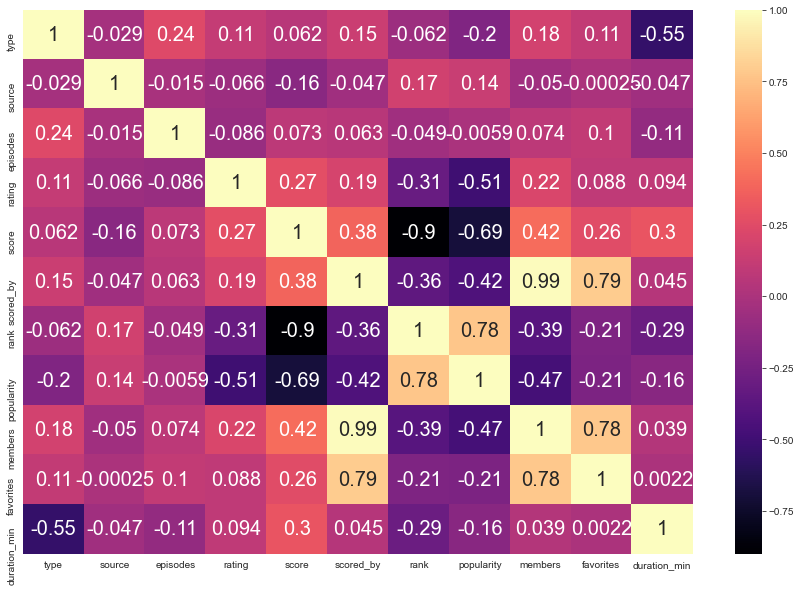

In [22]:
# Graphed the correlation matrix using a heat map (easier to read)
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(corr, annot = True, annot_kws ={'size':20}, cmap='magma')


In [23]:
# Checking correlations in data where the correlation is greater then 75% (highly correlated)
corr[abs(df_predictors.corr() > 0.75)]

,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min
type,1.00,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
source,nan,1.00,nan,nan,nan,nan,nan,nan,nan,nan,nan
episodes,nan,nan,1.00,nan,nan,nan,nan,nan,nan,nan,nan
rating,nan,nan,nan,1.00,nan,nan,nan,nan,nan,nan,nan
score,nan,nan,nan,nan,1.00,nan,nan,nan,nan,nan,nan
scored_by,nan,nan,nan,nan,nan,1.00,nan,nan,0.99,0.79,nan
rank,nan,nan,nan,nan,nan,nan,1.00,0.78,nan,nan,nan
popularity,nan,nan,nan,nan,nan,nan,0.78,1.00,nan,nan,nan
members,nan,nan,nan,nan,nan,0.99,nan,nan,1.00,0.78,nan
favorites,nan,nan,nan,nan,nan,0.79,nan,nan,0.78,1.00,nan


<AxesSubplot:>

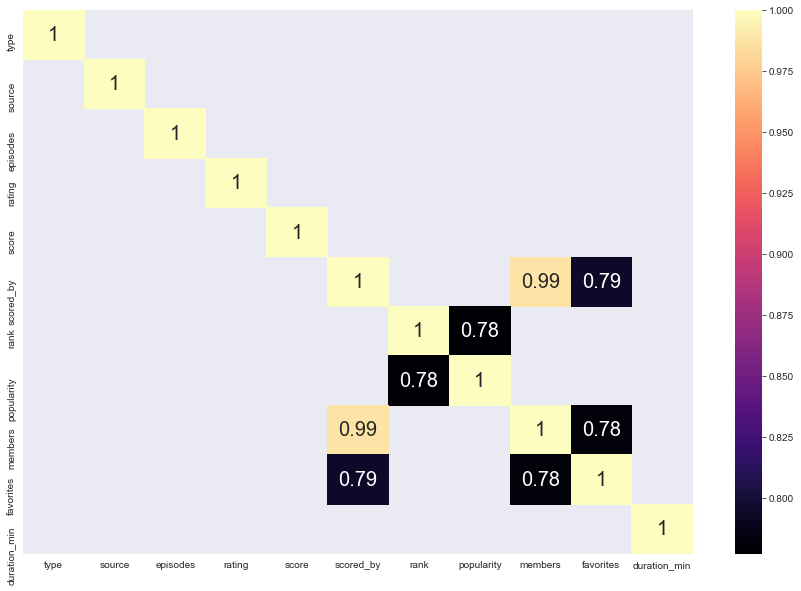

In [24]:
# Graphed the correlation matrix using a heat map (easier to read)
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(corr[abs(df_predictors.corr() > 0.75)], annot = True, annot_kws ={'size':20}, cmap='magma')

In [25]:
# Checking correlations in data where the correlation is less then -75% (highly inversely correlated)
corr[abs(df_predictors.corr() < -0.75)] 

,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min
type,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
source,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
episodes,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
rating,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
score,nan,nan,nan,nan,nan,nan,-0.90,nan,nan,nan,nan
scored_by,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
rank,nan,nan,nan,nan,-0.90,nan,nan,nan,nan,nan,nan
popularity,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
members,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan
favorites,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan


<AxesSubplot:>

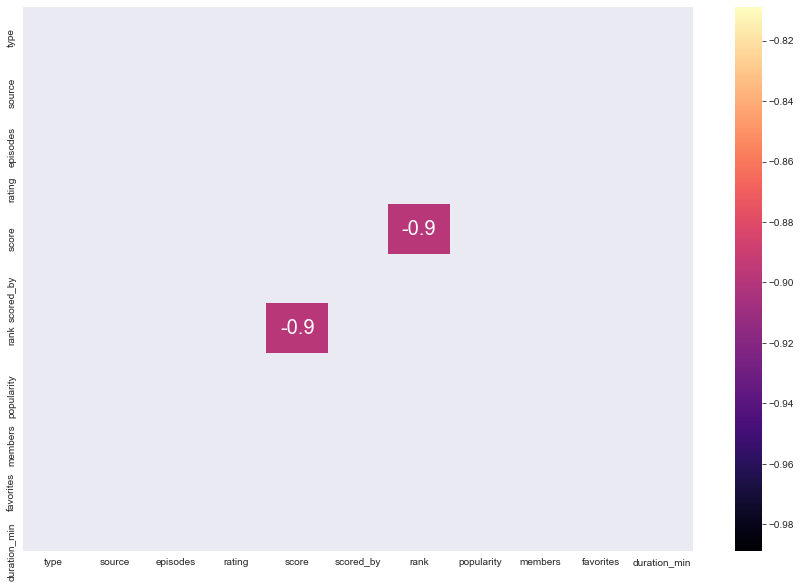

In [26]:
# Graphed the correlation matrix using a heat map (easier to read)
fig, ax = plt.subplots(figsize=(15,10))
sns.heatmap(corr[abs(df_predictors.corr() < -0.75)] , annot = True, annot_kws ={'size':20}, cmap='magma')

In [27]:
X = df.drop(['title','score'],axis=1)
y = df['score']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3, random_state=3)


In [28]:
def get_stats():
    columns_used = [X.columns[i] for i,value in enumerate(X.columns)]
    x = X[columns_used]
    return sm.OLS(y,x).fit().summary()
    
get_stats()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  score   R-squared (uncentered):                   0.997
Model:                            OLS   Adj. R-squared (uncentered):              0.997
Method:                 Least Squares   F-statistic:                          1.692e+05
Date:                Fri, 18 Jun 2021   Prob (F-statistic):                        0.00
Time:                        20:57:57   Log-Likelihood:                         -3211.5
No. Observations:                6312   AIC:                                      6445.
Df Residuals:                    6301   BIC:                                      6519.
Df Model:                          11                                                  
Covariance Type:            nonrobust                                                  
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
type                0.0226      0.004      5.987      0.000       0.015       0.030
source             -0.0020      0.002     -1.050      0.294      -0.006       0.002
episodes            0.0006      0.000      4.492      0.000       0.000       0.001
rating             -0.0045      0.004     -1.055      0.291      -0.013       0.004
scored_by       -2.351e-06   5.45e-07     -4.315      0.000   -3.42e-06   -1.28e-06
rank               -0.0003   2.71e-06    -96.847      0.000      -0.000      -0.000
popularity       1.795e-05   2.79e-06      6.424      0.000    1.25e-05    2.34e-05
members          1.792e-06   3.24e-07      5.527      0.000    1.16e-06    2.43e-06
favorites        1.009e-05    2.2e-06      4.578      0.000    5.77e-06    1.44e-05
duration_min        0.0031      0.000     12.399      0.000       0.003       0.004
aired_from_year     0.0039    1.5e-05    257.337      0.000       0.004       0.004
==============================================================================
Omnibus:                     2972.171   Durbin-Watson:                   2.105
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           427384.221
Skew:                          -1.212   Prob(JB):                         0.00
Kurtosis:                      43.239   Cond. No.                     1.15e+05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.15e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [29]:
# # Removing all features with a p-value higher then alpha (0.05) from above OLM summary
# # all remaining variables are said to be statistically significant.
# X = X.drop(['source','rating'],axis=1

In [30]:
X.head()

,type,source,episodes,rating,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
0,5,6,12,3,139250,1274,231,283882,2809,24.00,2012
1,5,6,26,3,91206,727,366,204003,2579,24.00,2007
2,5,6,51,2,37129,1508,1173,70127,802,24.00,2008
3,5,9,38,3,36501,307,916,93312,3344,16.00,2002
4,5,6,25,3,107767,50,426,182765,2082,24.00,2012


### Checking the relationships between the different categories

Visualizing relationship with each column of my dataset

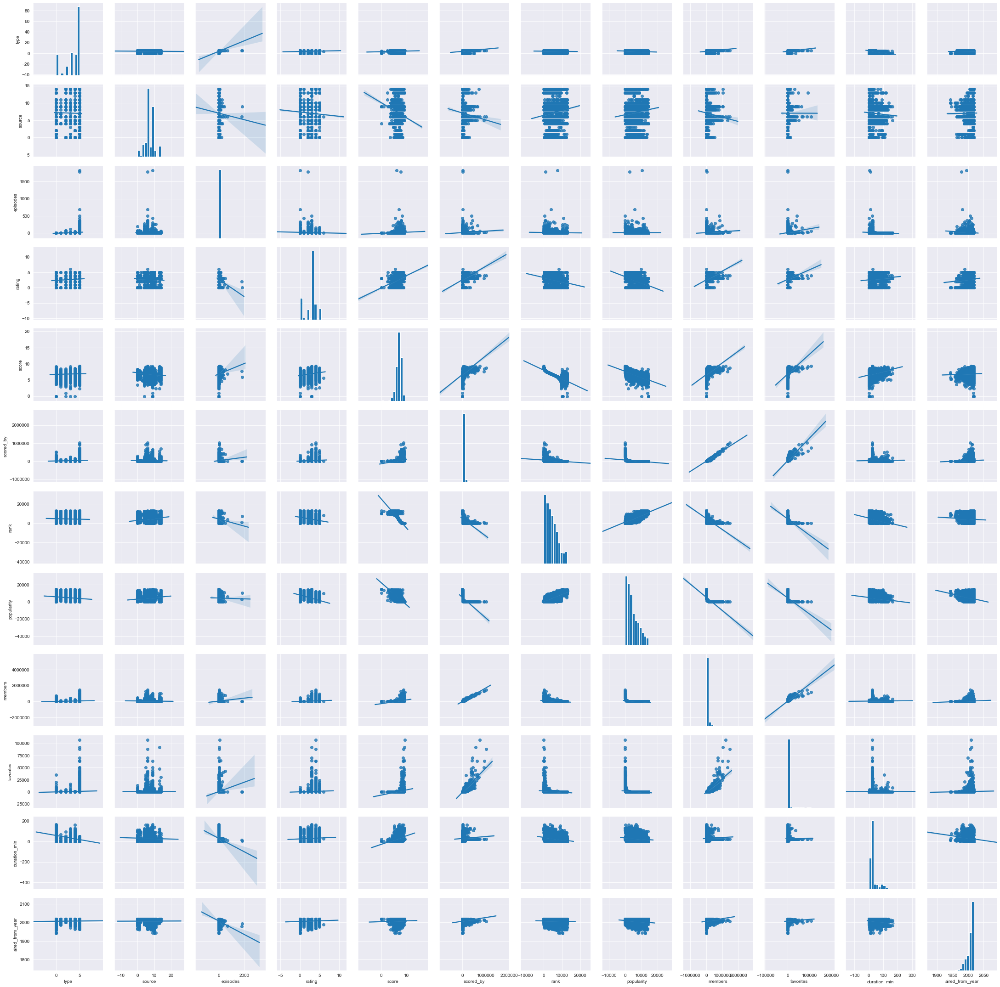

In [31]:
sns.pairplot(df, kind='reg' )

Box plot of the relationship for type against rank and score

([<matplotlib.axis.XTick at 0x17e573f73c8>,
 <a list of 6 Text xticklabel objects>)

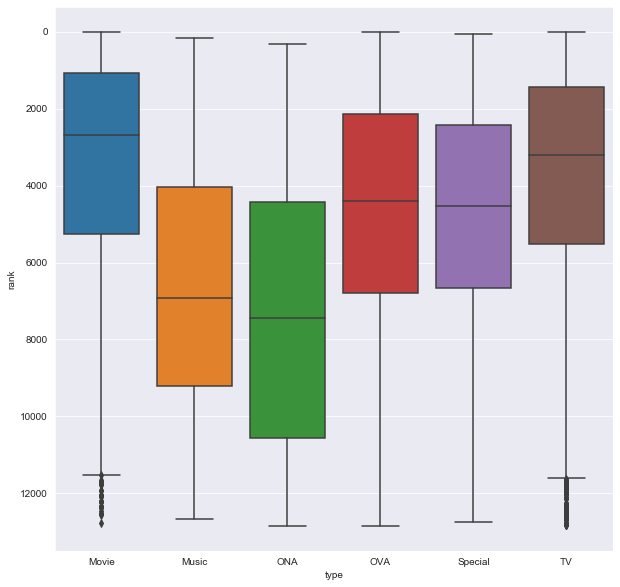

In [32]:
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=df, x='type' ,y= 'rank', orient='v')
plt.gca().invert_yaxis()
plt.xticks(np.arange(6), ('Movie', 'Music', 'ONA', 'OVA', 'Special','TV'))

([<matplotlib.axis.XTick at 0x17e600a1648>,
 <a list of 6 Text xticklabel objects>)

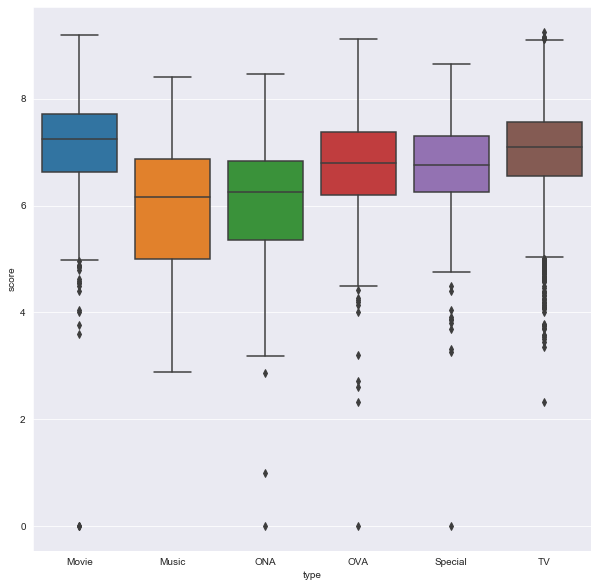

In [33]:
fig, ax = plt.subplots(figsize=(10,10))
sns.boxplot(data=df, x='type' ,y= 'score', orient='v', )
plt.xticks(np.arange(6), ('Movie', 'Music', 'ONA', 'OVA', 'Special','TV'))

Swarmplot of the relationship between the source and score with the different colors showing the rating (where 0 is all ages and brown is R+)

([<matplotlib.axis.XTick at 0x17e60113748>,
 <a list of 15 Text xticklabel objects>)

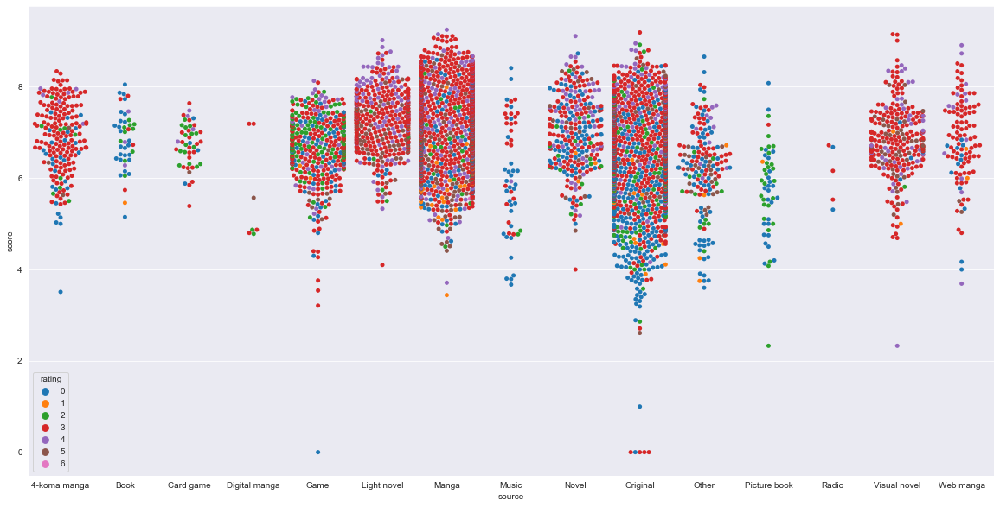

In [34]:
fig, ax = plt.subplots(figsize=(20,10))
sns.swarmplot(data=df, x='source' ,y= 'score', size=5, orient='v', hue='rating')
plt.xticks(np.arange(len(df_list_source)), df_list_source)


C:\Users\sdman\Anaconda3\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\sdman\Anaconda3\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


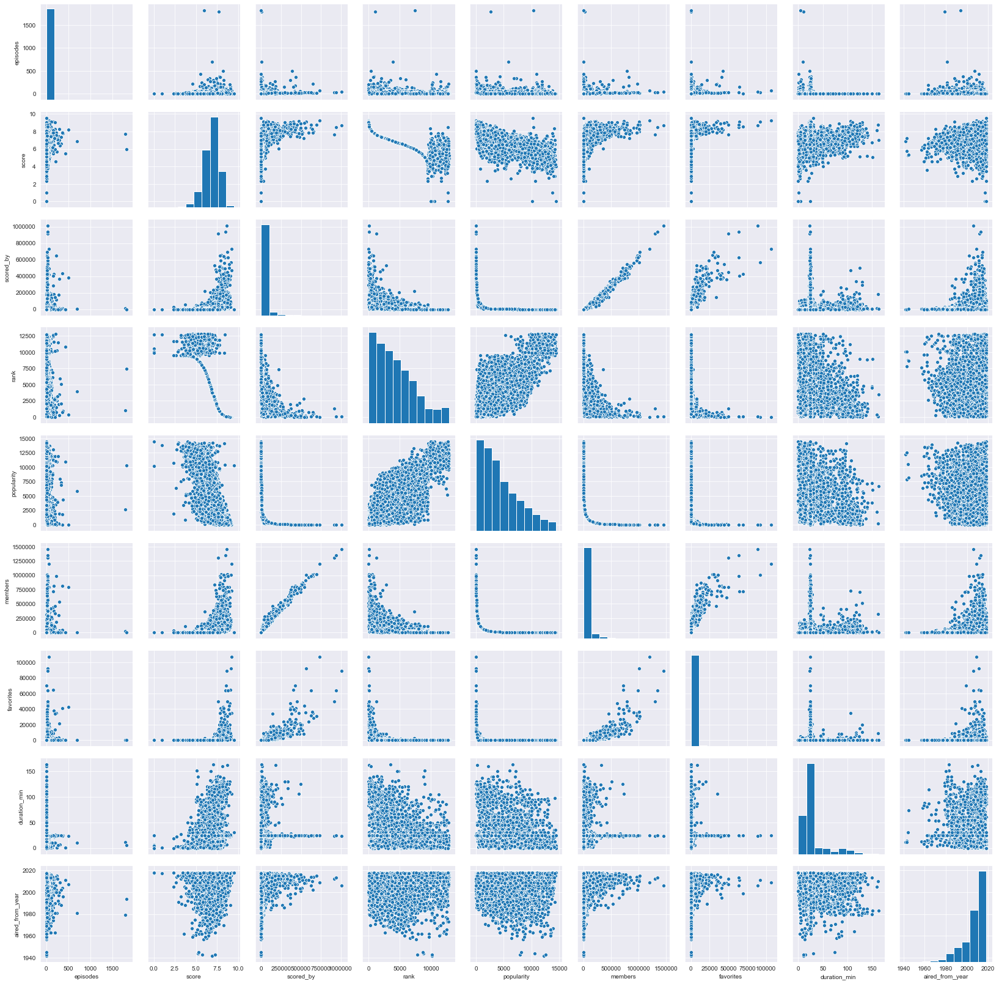

In [35]:
sns.pairplot(df_number_set)

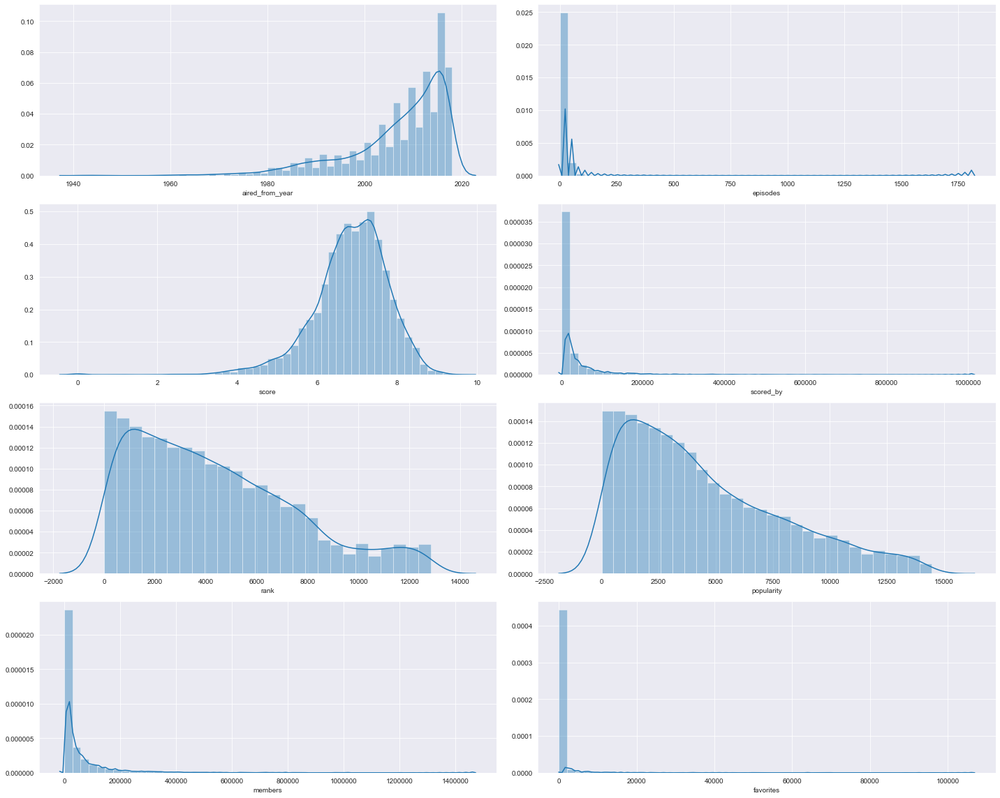

In [53]:
rows = 4
cols = 2
fig, ax = plt.subplots(nrows = rows, ncols = cols, figsize = (20,16))
col = df_number_set.columns.dropna()
index = -1
for i in range(rows):
    for j in range(cols):
        sns.distplot(df_number_set[col[index]].dropna(how='all'), ax = ax[i][j])
        index = index + 1
plt.tight_layout()

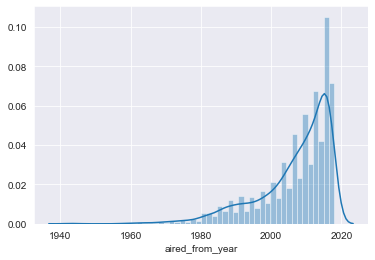

In [68]:
sns.distplot(df.aired_from_year)

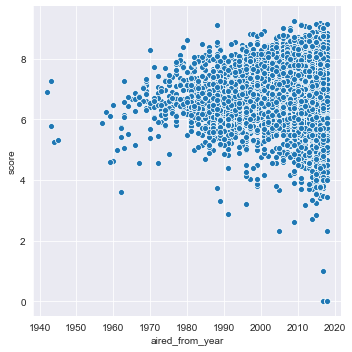

In [85]:
sns.relplot(data=df, x="aired_from_year", y="score")

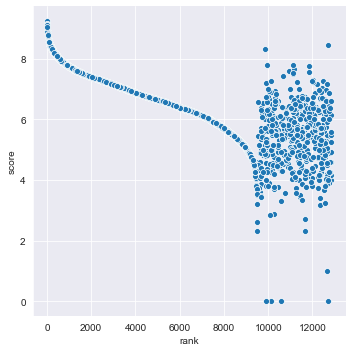

In [86]:
sns.relplot(data=df, x="rank", y="score")

In [92]:
high_scored_anime = df[df['score']>=8]
high_scored_anime = high_scored_anime.loc[:]
high_scored_anime

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
3,Princess Tutu,5,9,38,3,8.21,36501,307,916,93312,3344,16.0,2002
4,Bakuman. 3rd Season,5,6,25,3,8.67,107767,50,426,182765,2082,24.0,2012
5,Yume-iro Pâtissière,5,6,50,0,8.03,21618,526,1630,45625,826,24.0,2009
8,Nodame Cantabile: Paris-hen,5,6,11,3,8.24,53908,281,988,85660,282,23.0,2008
9,Ouran Koukou Host Club,5,6,26,3,8.34,335137,205,69,538843,24072,23.0,2006
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6558,No Game No Life: Zero,0,5,1,3,8.74,78743,40,320,225372,3008,106.0,2017
6559,Ookiku Furikabutte,5,6,25,3,8.06,25390,479,1340,60550,1474,25.0,2007
6579,Code Geass: Hangyaku no Lelouch,5,9,25,4,8.79,627740,30,9,986897,63614,24.0,2006
6582,Kara no Kyoukai: Mirai Fukuin,0,5,1,4,8.09,25600,447,1408,56473,146,90.0,2013


In [95]:
high_scored_anime.describe()

,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
count,547.000000,547.000000,547.000000,547.000000,547.000000,5.470000e+02,547.000000,547.000000,5.470000e+02,547.000000,547.000000,547.000000
mean,3.625229,6.910420,20.140768,3.133455,8.309927,1.091520e+05,317.603291,1061.166362,2.029176e+05,5442.442413,41.475320,2009.142596
std,2.008303,2.209955,35.850273,0.982687,0.253982,1.369647e+05,689.024897,1235.901747,2.229745e+05,11565.495061,33.916954,7.861074
min,0.000000,0.000000,0.000000,0.000000,8.000000,6.000000e+00,1.000000,1.000000,3.800000e+01,0.000000,2.000000,1970.000000
25%,3.000000,6.000000,1.000000,3.000000,8.120000,2.422150e+04,137.500000,253.500000,5.363050e+04,309.500000,23.000000,2006.000000
50%,5.000000,6.000000,12.000000,3.000000,8.240000,6.056000e+04,277.000000,674.000000,1.247070e+05,1244.000000,24.000000,2011.000000
75%,5.000000,8.000000,25.000000,4.000000,8.445000,1.356615e+05,417.500000,1465.500000,2.693230e+05,4886.500000,42.500000,2015.000000
max,5.000000,14.000000,500.000000,5.000000,9.250000,1.009477e+06,12681.000000,14119.000000,1.456378e+06,106895.000000,162.000000,2018.000000


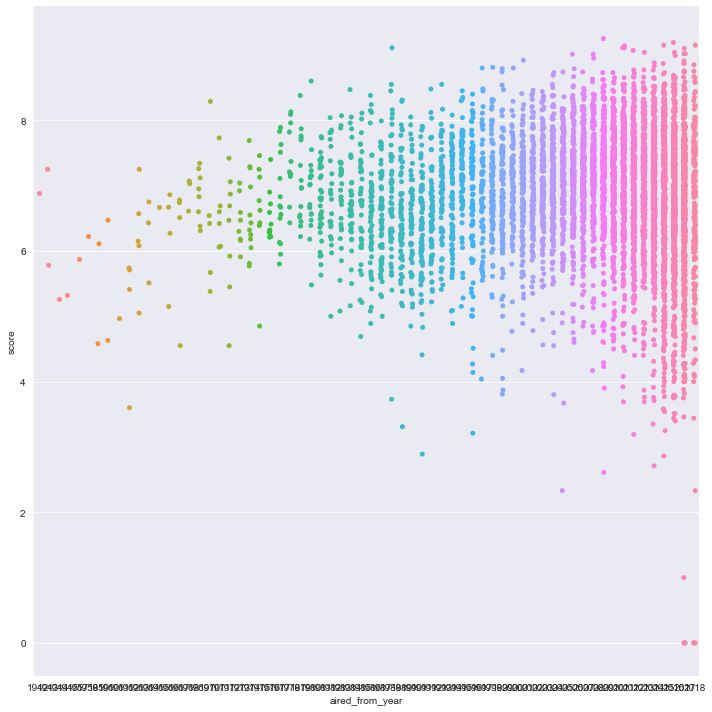

In [129]:
high_score_count = pd.DataFrame(high_scored_anime['score'].value_counts()).reset_index()

sns.catplot(data = df,x="aired_from_year", y="score",height=10)


In [90]:
low_scored_anime = df[df['score']<=3]
low_scored_anime = low_scored_anime.loc[:]
low_scored_anime

,title,type,source,episodes,rating,score,scored_by,rank,popularity,members,favorites,duration_min,aired_from_year
1781,Abunai Sisters: Koko & Mika,3,9,10,5,2.61,1217,9510,6321,2572,19,3.00,2009
2373,Gum Shaara,1,9,1,0,2.89,9,10283,14241,31,0,2.00,1991
4057,Hametsu no Mars,3,13,1,4,2.33,24281,9514,1949,34524,202,19.00,2005
4695,Oshiri Tantei,5,11,3,2,2.33,3,11659,10713,261,0,0.00,2018
5988,Ore to Issho ni Training,3,9,1,3,2.71,7,11643,13078,95,0,22.00,2014
6625,Fettu to Ccine to Gummi Seijin,2,9,1,2,2.86,14,10084,13979,48,0,3.00,2015
6636,Woo to Wah,2,9,0,0,1.00,3,12678,13790,62,0,0.25,2017
6640,Inazuma Eleven Reloaded: Reformation of Soccer,4,4,1,0,0.00,0,10587,14429,610,0,24.00,2018
6644,Free!: Take Your Marks: Character Butai Aisatsu,0,9,4,3,0.00,0,10120,14427,364,0,6.00,2017
6648,Free! Movie 2: Timeless Medley - Yakusoku: Cha...,0,9,4,3,0.00,0,10119,14426,261,0,5.00,2017


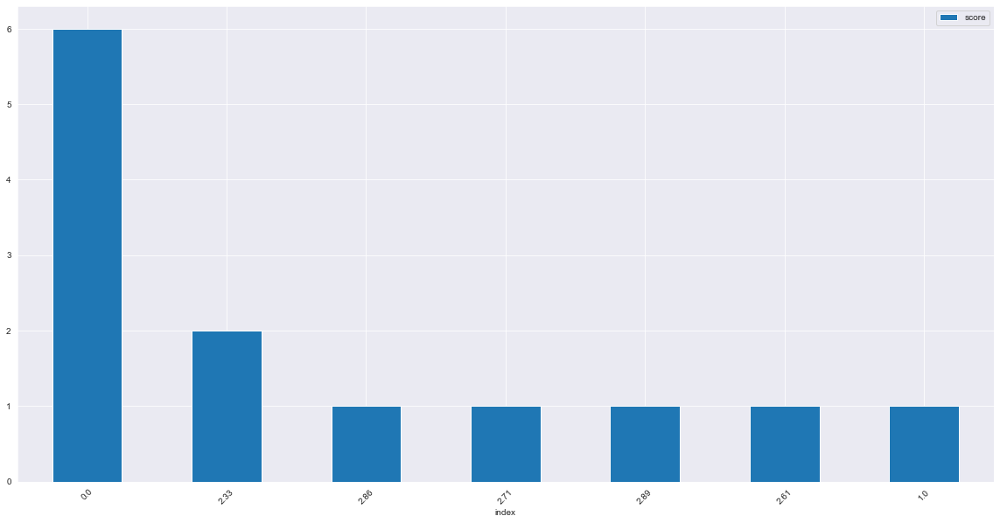

In [115]:
low_score_count = pd.DataFrame(low_scored_anime['score'].value_counts()).reset_index()

low_score_count.plot(x="index", y="score", kind="bar",rot =45,figsize=(20,10))

# Multiple Linear Regression

In [21]:
X = df.drop(['title','score'],axis=1)
y = df['score']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3, random_state=3)


In [32]:
def multi_linear_regression_modeling(independent_variable,dependent_variable):
    #  fitting the independent variable(X) and the dependent variable(Y) to Linear Regression object (for easier calling)
    globals () ['mlr'] = LinearRegression().fit(independent_variable,dependent_variable)
    # assigning predictions to global variable (Yhat_mlr) to be called outside of function, using independent variable(X)
    globals() ['Yhat_mlr'] = mlr.predict(independent_variable)
    globals() ['columns_used'] = [independent_variable.columns[i] for i,value in enumerate(independent_variable.columns)]
    
    ##     𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + 𝑏4 𝑋4 ...     ##
    # intercept (a)
    print(f'The intercept of the regression line is {mlr.intercept_}')
    # slope (b)
    print(f'The slopes of the regression line is {mlr.coef_}')
    print('\n\033[1m    𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... \nPlugging in the actual values the multiple linear regression formula:\033[0m')
    
    
    # printing the multiple linear regression formula with variables plugged in
    formula = (f'\033[1m{dependent_variable.name}\033[0m = {mlr.intercept_}')
    for i,col in enumerate(independent_variable.columns):
        slope_times_feature = f' + ({mlr.coef_[i]} * \033[1m{independent_variable.columns[i]}\033[0m)'
        formula += str(slope_times_feature)
    print(formula)   
    
    globals() ['r_square'] = mlr.score(independent_variable,dependent_variable)
    print(f'\n\n\033[1mThe R-square is: {r_square}\033[0m')
    print(f'We can say that \033[1m~{round(r_square*100,2)}%\033[0m of the variation of the {dependent_variable.name} is explained by this multiple linear model fitted with \033[1m{columns_used}\033[0m.\n')
    globals() ['mse'] = mean_squared_error(dependent_variable, Yhat_mlr)
    print(f'\033[1mThe mean square error of price and predicted values is: \033[0m', mse)
    
    
    plt.figure(figsize=(12, 10))
    ax1 = sns.distplot(dependent_variable, hist=False, color="r", label="Actual Value")
    sns.distplot(Yhat_mlr, hist=False, color="b", label="Fitted Values" , ax=ax1)


    plt.title(f'Actual vs Fitted Values for {dependent_variable.name.title()}')
    plt.xlabel(dependent_variable.name.title())
    plt.ylabel('Proportion of Anime')

    plt.show()
    plt.close()

The intercept of the regression line is 8.472626735946434
The slopes of the regression line is [ 1.71221826e-02 -1.97923941e-03  4.22802868e-04 -7.20841353e-03
 -2.77511937e-06 -2.59717588e-04  1.18190282e-05  2.08786579e-06
  9.37245504e-06  2.59293559e-03 -3.41625913e-04]

    𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... 
Plugging in the actual values the multiple linear regression formula:
score = 8.472626735946434 + (0.01712218258934341 * type) + (-0.0019792394057766664 * source) + (0.00042280286812459154 * episodes) + (-0.0072084135326447914 * rating) + (-2.7751193733624316e-06 * scored_by) + (-0.00025971758839792795 * rank) + (1.1819028190696972e-05 * popularity) + (2.0878657896962385e-06 * members) + (9.372455042980606e-06 * favorites) + (0.0025929355949963775 * duration_min) + (-0.0003416259131009294 * aired_from_year)


The R-square is: 0.8184635508102259
We can say that ~81.85% of the variation of the score is explained by this multiple linear model fitted with ['type', 'source', 'e

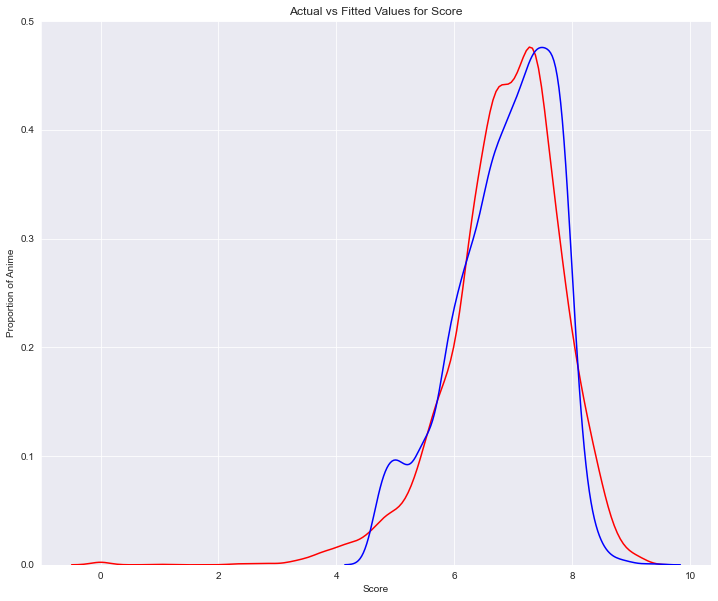

In [33]:
multi_linear_regression_modeling(X, y)

In [34]:
# function for multiple linear regression with cross validation

def cv_multi_linear_regression_modeling(independent_variable,dependent_variable,folds):
    globals () ['X_train', 'X_test', 'y_train', 'y_test'] = train_test_split(independent_variable,dependent_variable,test_size=0.3, random_state=3)
   
    globals() ['columns_used'] = [independent_variable.columns[i] for i,value in enumerate(independent_variable.columns)]
    # fitting the independent variable(X) and the dependent variable(Y) to Linear Regression object (for easier calling)
    globals () ['mlr'] = LinearRegression()
    
    # assigning predictions to global variable (Yhat_mlr_cv) to be called outside of function, using X_train
    globals() ['Yhat_mlr_cv'] = cross_val_predict(mlr, X_train,y_train, cv = folds)
    
    # gets cross validation R^2 score 
    def get_cv_scores(model,folds):
        globals() ['cv_scores'] = cross_val_score(model,
                                                  X_train, 
                                                  y_train,
                                                  cv=folds,
                                                  scoring='r2')
    get_cv_scores(mlr,folds)
  
    globals() ['CV_r_square'] = np.mean(cv_scores)
    print(f'\n\n\033[1mThe Avg cross validation R-square (with {folds} folds) is: {CV_r_square}\033[0m')
    globals() ['STD'] = np.std(cv_scores)
    print(f'\n\033[1mWith a Standard Diviation of the R-squares: {STD}\n\033[0m')

    print(f'We can say that \033[1m~{round(CV_r_square*100,2)}%\033[0m of the variation of the {dependent_variable.name} is explained by this multiple linear model fitted with \033[1m{columns_used}\033[0m.\n')
    globals() ['mse'] = mean_squared_error(y_train, Yhat_mlr_cv)
    print(f'\033[1mThe mean square error of predicted values is: \033[0m', mse)
    
    
    mlr.fit(X_train,y_train)
    y_hat = mlr.predict(X_test)      #this gives me my predictions

    print(f"\nThe model's performance score is {mlr.score(X_test, y_test)}")     #this tells me my model performance

    
    ##     𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... + 𝑏n 𝑋n    ##
    # intercept (a)
    print(f'\n\nThe intercept of the regression line is {mlr.intercept_}')
    # slope (b)
    print(f'The slopes of the regression line are {mlr.coef_}')
    print('\n\033[1m    𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... + 𝑏n 𝑋n \nPlugging in the actual values the multiple linear regression formula:\033[0m')
    
    # printing the multiple linear regression formula with variables plugged in 
    formula = (f'\033[1m[{dependent_variable.name.upper()}]\033[0m = {mlr.intercept_}')
    for i,col in enumerate(independent_variable.columns):
        slope_times_feature = f' + ({mlr.coef_[i]} * \033[1m{independent_variable.columns[i]}\033[0m)'
        formula += str(slope_times_feature)
    print(formula) 
  
    #plotting differences betwwen actual and predicted values
    
    plt.figure(figsize=(12, 10))
    #plotting actual target values
    ax1 = sns.distplot(dependent_variable, hist=False, color="r", label="Actual Value")
    #plotting predicted target values
    sns.distplot(Yhat_mlr_cv, hist=False, color="b", label="Cross Validation Fitted Values" , ax=ax1)
    sns.distplot(y_hat, hist=False, color="m", label="Fitted Values" , ax=ax1)
    
    plt.title(f'Actual vs Fitted Values for {dependent_variable.name.title()}')
    plt.xlabel(dependent_variable.name.title())
    plt.ylabel('Proportion based on total count')
    plt.show()
    plt.close()
    
  



The Avg cross validation R-square (with 5 folds) is: 0.8200950165333447

With a Standard Diviation of the R-squares: 0.03567209850703259

We can say that ~82.01% of the variation of the score is explained by this multiple linear model fitted with ['type', 'source', 'episodes', 'rating', 'scored_by', 'rank', 'popularity', 'members', 'favorites', 'duration_min', 'aired_from_year'].

The mean square error of predicted values is:  0.16348931643629774

The model's performance score is 0.8074600711513504


The intercept of the regression line is 6.876735224810314
The slopes of the regression line are [ 8.81183037e-03 -2.55348710e-03  1.75131774e-03 -2.13228266e-03
 -2.89433605e-06 -2.59667776e-04  9.85415018e-06  2.06741877e-06
  9.92708478e-06  2.37689537e-03  4.62591015e-04]

    𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... + 𝑏n 𝑋n 
Plugging in the actual values the multiple linear regression formula:
[SCORE] = 6.876735224810314 + (0.008811830374222642 * type) + (-0.0025534871023349466 * source

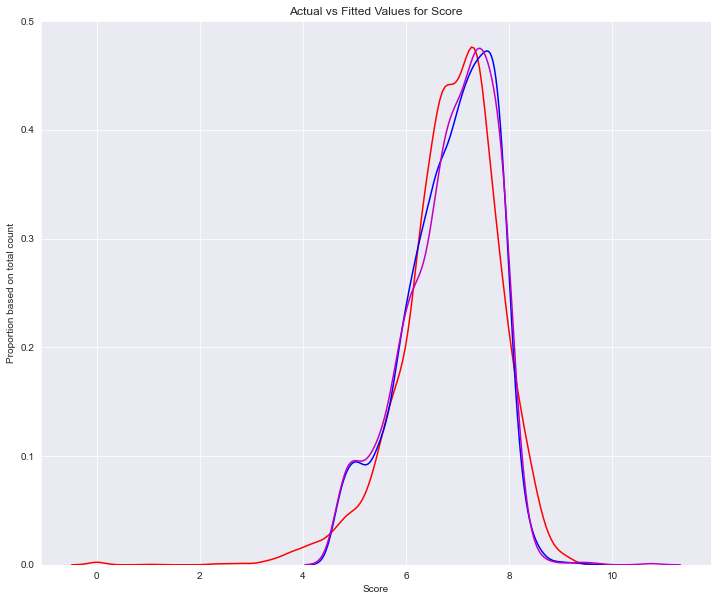

In [35]:
cv_multi_linear_regression_modeling(X, y, 5)

R-square is: 0.8183936035825073
mean square error is:  0.16209149042806653



The Avg cross validation R-square (with 50 folds) is: 0.8260895040316654

With a Standard Diviation of the R-squares: 0.08583498510437454

We can say that ~82.61% of the variation of the score is explained by this multiple linear model fitted with ['type', 'source', 'episodes', 'rating', 'scored_by', 'rank', 'popularity', 'members', 'favorites', 'duration_min', 'aired_from_year'].

The mean square error of predicted values is:  0.16340820527536837

The model's performance score is 0.8074600711513504


The intercept of the regression line is 6.876735224810314
The slopes of the regression line are [ 8.81183037e-03 -2.55348710e-03  1.75131774e-03 -2.13228266e-03
 -2.89433605e-06 -2.59667776e-04  9.85415018e-06  2.06741877e-06
  9.92708478e-06  2.37689537e-03  4.62591015e-04]

    𝑌ℎ𝑎𝑡 = 𝑎 + 𝑏1 𝑋1 + 𝑏2 𝑋2 +𝑏3 𝑋3 + ... + 𝑏n 𝑋n 
Plugging in the actual values the multiple linear regression formula:
[SCORE] = 6.876735224810314 + (0.008811830374222642 * type) + (-0.0025534871023349466 * sourc

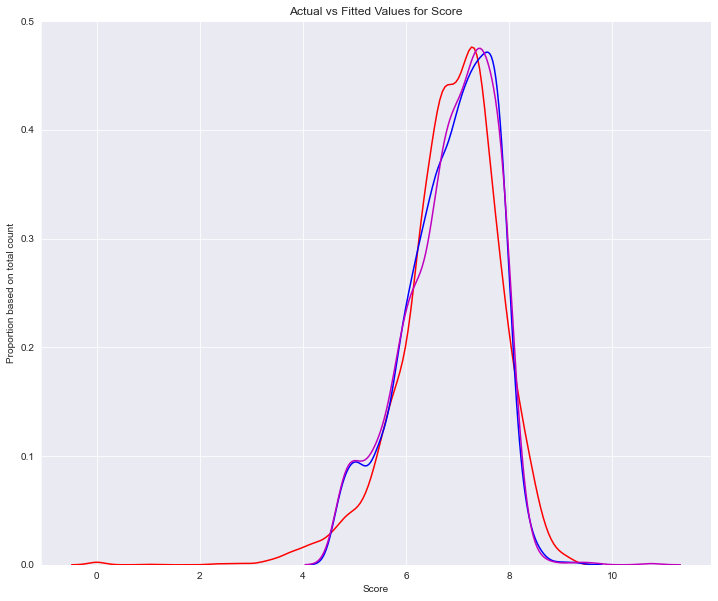

In [36]:
cv_multi_linear_regression_modeling(X, y,50)

In [37]:
coeff = pd.DataFrame()
coeff["Columns"] = X_train.columns
coeff["Linear_Regession_Coefficients"] = pd.Series(mlr.coef_)
coeff

,Columns,Linear_Regession_Coefficients
0,type,0.01
1,source,-0.00
2,episodes,0.00
3,rating,-0.00
4,scored_by,-0.00
5,rank,-0.00
6,popularity,0.00
7,members,0.00
8,favorites,0.00
9,duration_min,0.00


# GridSearch 

## Ridge Regression GridSearch

In [46]:
# find optimal parameters with grid search

space = dict()
space['solver'] = ['svd', 'cholesky', 'lsqr', 'sag']
space['alpha'] = [0.00001, 0.0001, 0.001, 0.01, 0.1, 1, 10, 100,1000,10000]
space['fit_intercept'] = [True, False]
space['normalize'] = [True, False]
grid_rr = GridSearchCV(Ridge(random_state=3), space, scoring='r2', verbose=1, n_jobs=-1,cv=50)
grid_result_rr = grid_rr.fit(X_train, y_train)
print('Best Score: ', grid_result_rr.best_score_)
print('Best Params: ', grid_result_rr.best_params_)

Fitting 50 folds for each of 160 candidates, totalling 8000 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    2.7s
[Parallel(n_jobs=-1)]: Done 1051 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done 2423 tasks      | elapsed:   43.0s
[Parallel(n_jobs=-1)]: Done 4620 tasks      | elapsed:  1.3min


Best Score:  0.8262396895821144
Best Params:  {'alpha': 10000, 'fit_intercept': True, 'normalize': False, 'solver': 'svd'}


[Parallel(n_jobs=-1)]: Done 8000 out of 8000 | elapsed:  2.4min finished


In [47]:

coeff["Ridge_Regession_Coefficients"] = pd.Series(grid_result_rr.best_estimator_.coef_)
coeff

,Columns,Linear_Regession_Coefficients,Ridge_Regession_Coefficients
0,type,0.008812,0.003625
1,source,-0.002553,-0.001967
2,episodes,0.001751,0.001849
3,rating,-0.002132,-0.000670
4,scored_by,-0.000003,-0.000003
5,rank,-0.000260,-0.000260
6,popularity,0.000010,0.000010
7,members,0.000002,0.000002
8,favorites,0.000010,0.000010
9,duration_min,0.002377,0.002168


In [48]:
print(f"Ridge Regression model's Test score: {round(grid_result_rr.best_estimator_.score(X_test, y_test)*100,2)}")

Ridge Regression model's Test score: 80.57


## Lasso Regression GridSearch

In [49]:
# find optimal parameters with grid search

param_grid ={'alpha': [0,0.00001, 0.0001, 0.001, 0.01,0.05, 0.1, 0.15, 0.2, 0.3, 0.4, 0.5, 0.6, 0.8, 1],
            'normalize': [True,False],
            'fit_intercept': [True,False]}

grid_lasso = GridSearchCV(Lasso(random_state=3), param_grid, scoring='r2', verbose=1, n_jobs=-1,cv=50)
grid_result_lasso = grid_lasso.fit(X_train, y_train)
print(f'Best Score: {grid_result_lasso.best_score_}')
print(f'Best Params: {grid_result_lasso.best_params_}')

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 50 folds for each of 60 candidates, totalling 3000 fits


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 1023 tasks      | elapsed:   17.6s
[Parallel(n_jobs=-1)]: Done 2423 tasks      | elapsed:   29.0s


Best Score: 0.826447509941368
Best Params: {'alpha': 0.15, 'fit_intercept': True, 'normalize': False}


[Parallel(n_jobs=-1)]: Done 3000 out of 3000 | elapsed:   33.0s finished


In [50]:
Lasso().get_params().keys()

dict_keys(['alpha', 'copy_X', 'fit_intercept', 'max_iter', 'normalize', 'positive', 'precompute', 'random_state', 'selection', 'tol', 'warm_start'])

In [51]:
Lasso().get_params().values()

dict_values([1.0, True, True, 1000, False, False, False, None, 'cyclic', 0.0001, False])

In [52]:
coeff["Lasso_Regession_Coefficients"] = pd.Series(grid_result_lasso.best_estimator_.coef_)
coeff

,Columns,Linear_Regession_Coefficients,Ridge_Regession_Coefficients,Lasso_Regession_Coefficients
0,type,0.008812,0.003625,0.000000
1,source,-0.002553,-0.001967,-0.000000
2,episodes,0.001751,0.001849,0.001579
3,rating,-0.002132,-0.000670,-0.000000
4,scored_by,-0.000003,-0.000003,-0.000003
5,rank,-0.000260,-0.000260,-0.000261
6,popularity,0.000010,0.000010,0.000009
7,members,0.000002,0.000002,0.000002
8,favorites,0.000010,0.000010,0.000010
9,duration_min,0.002377,0.002168,0.001710


In [53]:
print(f"Lasso Regression model's Test score: {round(grid_result_lasso.best_estimator_.score(X_test, y_test)*100,2)}")

Lasso Regression model's Test score: 80.96


## Elastic Net Regression GridSearch

In [54]:
# from sklearn.linear_model import ElasticNet

# find optimal parameters with grid search

param_grid ={'alpha': [0.00001, 0.0001, 0.001, 0.01, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1],
            'fit_intercept': [True,False],
            'l1_ratio': np.arange(0.0, 1.0, 0.1)}

grid_e_net = GridSearchCV(ElasticNet(random_state=3), param_grid, scoring='r2', verbose=1, n_jobs=-1,cv=20)
grid_result_e_net = grid_e_net.fit(X_train, y_train)
print(f'Best Score: {grid_result_e_net.best_score_}')
print(f'Best Params: {grid_result_e_net.best_params_}')



[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.


Fitting 20 folds for each of 280 candidates, totalling 5600 fits


[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   11.4s
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed:   19.4s
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed:   29.0s
[Parallel(n_jobs=-1)]: Done 1964 tasks      | elapsed:   40.1s
[Parallel(n_jobs=-1)]: Done 3264 tasks      | elapsed:   56.5s
[Parallel(n_jobs=-1)]: Done 4764 tasks      | elapsed:  1.2min


Best Score: 0.8233999114821959
Best Params: {'alpha': 0.9, 'fit_intercept': True, 'l1_ratio': 0.1}


[Parallel(n_jobs=-1)]: Done 5600 out of 5600 | elapsed:  1.4min finished


In [55]:
coeff["Elastic_Net_Regession_Coefficients"] = pd.Series(grid_result_e_net.best_estimator_.coef_)
coeff

,Columns,Linear_Regession_Coefficients,Ridge_Regession_Coefficients,Lasso_Regession_Coefficients,Elastic_Net_Regession_Coefficients
0,type,0.008812,0.003625,0.000000,0.000000
1,source,-0.002553,-0.001967,-0.000000,-0.000000
2,episodes,0.001751,0.001849,0.001579,0.001706
3,rating,-0.002132,-0.000670,-0.000000,-0.000000
4,scored_by,-0.000003,-0.000003,-0.000003,-0.000003
5,rank,-0.000260,-0.000260,-0.000261,-0.000261
6,popularity,0.000010,0.000010,0.000009,0.000009
7,members,0.000002,0.000002,0.000002,0.000002
8,favorites,0.000010,0.000010,0.000010,0.000010
9,duration_min,0.002377,0.002168,0.001710,0.001828


In [38]:
print(f"Elastic Net Regression model's Test score: {round(grid_result_e_net.best_estimator_.score(X_test, y_test)*100,2)}")

Elastic Net Regression model's Test score: 80.78


##  Support Vector Machine for Regression GridSearch

In [33]:
# from sklearn.preprocessing import StandardScaler


# find optimal parameters with grid search



param_grid ={'kernel' : ['poly', 'rbf', 'sigmoid'],
            'C' : [1, 10,100],
            'epsilon': [0.0001, 0.001, 0.01, 0.1, 1],
            'coef0' : np.arange(2,5,0.5)
            }

grid_svr = GridSearchCV(SVR(), param_grid, scoring='r2', verbose=1, n_jobs=-1,cv=5)
grid_result_svr = grid_svr.fit(X_train, y_train)
print(f'Best Score: {grid_result_svr.best_score_}')
print(f'Best Params: {grid_result_svr.best_params_}')



Fitting 5 folds for each of 270 candidates, totalling 1350 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:  1.2min
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed: 12.5min
[Parallel(n_jobs=-1)]: Done 784 tasks      | elapsed: 73.8min
[Parallel(n_jobs=-1)]: Done 1234 tasks      | elapsed: 342.7min
[Parallel(n_jobs=-1)]: Done 1350 out of 1350 | elapsed: 420.6min finished


Best Score: 0.8235814712308163
Best Params: {'C': 10, 'coef0': 4.5, 'epsilon': 0.01, 'kernel': 'poly'}


In [34]:
coeff["Support_Vector_Machine_Regession_Coefficients"] = pd.Series(grid_result_svr.best_estimator_.coef_)
coeff

AttributeError: coef_ is only available when using a linear kernel

In [35]:
print(f"Support Vector Machine for Regression model's Test score: {round(grid_result_svr.best_estimator_.score(X_test, y_test)*100,2)}")

Support Vector Machine for Regression model's Test score: 82.4


In [36]:

# Support Vector Machine for Regression (GridSearch with best parameters)
svr = SVR(**grid_result_svr.best_params_)
# X = scaler.fit_transform(X)
svr.fit(X,y)
with open("support_vector_machine_regression_model.pkl", 'wb') as file:
        pickle.dump(svr, file)
# accuracy score
svr_score = svr.score(X_test, y_test)
print(f"Support Vector Machine for Regression model's Test score: {round(svr_score*100,2)}")

Support Vector Machine for Regression model's Test score: 82.32


##  Gradient Boosting Regression GridSearch

In [40]:
# from sklearn.ensemble import GradientBoostingRegressor

# find optimal parameters with grid search

param_grid ={'alpha': [0.000001, 0.00001, 0.0001, 0.001, 0.01, 0.1, 1],
            'loss': ['ls','lad','huber','quantile'],
            'learning_rate': np.arange(0, 0.4, 0.05),
            'n_estimators': np.arange(100, 300, 50)}

grid_gbr = GridSearchCV(GradientBoostingRegressor(random_state=3), param_grid, scoring='r2', verbose=2, n_jobs=-1,cv=20)
grid_result_gbr = grid_gbr.fit(X_train, y_train)
print(f'Best Score: {grid_result_gbr.best_score_}')
print(f'Best Params: {grid_result_gbr.best_params_}')



Fitting 20 folds for each of 448 candidates, totalling 8960 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:    2.6s
[Parallel(n_jobs=-1)]: Done 577 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 792 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 1075 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 1888 tasks      | elapsed:  4.9min
[Parallel(n_jobs=-1)]: Done 2333 tasks      | elapsed:  6.3min
[Parallel(n_jobs=-1)]: Done 3178 tasks      | elapsed:  8.2min
[Parallel(n_jobs=-1)]: Done 3785 tasks      | elapsed:  9.9min
[Parallel(n_jobs=-1)]: Done 4837 tasks      | elapsed: 12.7min
[Parallel(n_jobs=-1)]: Done 5807 tasks      | elapsed: 15.7min
[Parallel(n_jobs=-1)]: Done 7030 tasks      | elapsed: 20.1min
[Parallel(n_jobs=-1)]: Done 8960 out of 8960 | elapsed: 22.9min finished


Best Score: 0.9204221100836548
Best Params: {'alpha': 0.01, 'learning_rate': 0.25, 'loss': 'huber', 'n_estimators': 200}


In [123]:
coeff["Gradient_Boosting_Regession_Coefficients"] = pd.Series(grid_result_gbr.best_estimator_.coef_)
coeff

AttributeError: 'GradientBoostingRegressor' object has no attribute 'coef_'

In [43]:
print(f"Gradient Boosting Regression model's Test score: {round(grid_result_gbr.best_estimator_.score(X_test, y_test)*100,2)}")

Gradient Boosting Regression model's Test score: 93.37


# Extremely Randomized Trees Regressor with GridSearch

In [55]:
# find optimal parameters with grid search
from sklearn.ensemble import ExtraTreesRegressor

param_grid ={
#             'criterion': ['mse','mae'],
#             'max_features': ["auto", "sqrt", "log2"],
            'ccp_alpha': [0.0,0.2,0.4],
            'n_estimators': np.arange(100, 250, 50)}

grid_etr = GridSearchCV(ExtraTreesRegressor(random_state=3), param_grid, scoring='r2', verbose=2, n_jobs=-1,cv=50)
grid_result_etr = grid_etr.fit(X_train, y_train)
print(f'Best Score: {grid_result_etr.best_score_}')
print(f'Best Params: {grid_result_etr.best_params_}')

Fitting 50 folds for each of 9 candidates, totalling 450 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   17.9s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:  7.7min
[Parallel(n_jobs=-1)]: Done 450 out of 450 | elapsed: 11.4min finished


Best Score: 0.9205725168555665
Best Params: {'ccp_alpha': 0.0, 'n_estimators': 200}


In [56]:
print(f"Gradient Boosting Regression model's Test score: {round(grid_result_etr.best_estimator_.score(X_test, y_test)*100,2)}")

Gradient Boosting Regression model's Test score: 94.37


# Randomized Forest Regressor with GridSearch

In [25]:
# find optimal parameters with grid search
# from sklearn.ensemble import RandomForestRegressor

param_grid ={
#             'criterion': ['mse','mae'],
#             'max_features': ["auto", "sqrt", "log2"],
            'ccp_alpha': [0.0,0.2,0.4],
            'n_estimators': np.arange(100, 250, 50)}

grid_rfr = GridSearchCV(RandomForestRegressor(random_state=3), param_grid, scoring='r2', verbose=2, n_jobs=-1,cv=50)
grid_result_rfr = grid_rfr.fit(X_train, y_train)
print(f'Best Score: {grid_result_rfr.best_score_}')
print(f'Best Params: {grid_result_rfr.best_params_}')

Fitting 50 folds for each of 9 candidates, totalling 450 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:   11.8s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:  1.3min
[Parallel(n_jobs=-1)]: Done 349 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done 450 out of 450 | elapsed:  4.3min finished


Best Score: 0.9251533350992435
Best Params: {'ccp_alpha': 0.0, 'n_estimators': 200}


In [26]:
print(f"Randomized Forest Regressor model's Test score: {round(grid_result_rfr.best_estimator_.score(X_test, y_test)*100,2)}")

Randomized Forest Regressor model's Test score: 93.38


In [27]:
# Saving model
# # Randomized Forest Regression (GridSearch with best parameters)
# rfr = grid_result_rfr.best_estimator_
# rfr.fit(X,y)
# with open("random_forest_regression_model.pkl", 'wb') as file:
#         pickle.dump(rfr, file)


# Extreme Gradient Boosting (XGBoost) Regression

In [23]:
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)



param_grid = {
          # Parameters that we are going to tune.
          'booster': ['gbtree', 'gblinear', 'dart'],
          'max_depth': np.arange(5, 25, 5),
#           'min_child_weight': 1,
          'subsample': np.linspace(0.1, 1, 10),
          'colsample_bytree': np.linspace(0.5, 0.9, 5),
#           'eta':  [0.01, 0.05, 0.1, 0.2, 0.3],
          # Other parameters
          'objective':['reg:linear'],
          
         }


grid_xgb = GridSearchCV(xgb.XGBRegressor(random_state=3), param_grid, scoring='r2', verbose=2, n_jobs=-1,cv=5)
grid_result_xgb = grid_xgb.fit(X_train, y_train)
print(f'Best Score: {grid_result_xgb.best_score_}')
print(f'Best Params: {grid_result_xgb.best_params_}')

Fitting 5 folds for each of 600 candidates, totalling 3000 fits
[23:12:22] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.1.0/src/objective/regression_obj.cu:170: reg:linear is now deprecated in favor of reg:squarederror.
[23:12:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.1.0/src/objective/regression_obj.cu:170: reg:linear is now deprecated in favor of reg:squarederror.
Best Score: 0.9222004930163967
Best Params: {'booster': 'dart', 'colsample_bytree': 0.9, 'max_depth': 10, 'objective': 'reg:linear', 'subsample': 0.8}


In [27]:
dtrain = xgb.DMatrix(X_train, label=y_train)
dtest = xgb.DMatrix(X_test, label=y_test)



param_grid = {
          # Parameters that we are going to tune.
          'booster': ['gbtree', 'gblinear', 'dart'],
          'max_depth': np.arange(5, 25, 5),
#           'min_child_weight': 1,
          'subsample': np.linspace(0.1, 1, 10),
          'colsample_bytree': np.linspace(0.5, 0.9, 5),
#           'eta':  [0.01, 0.05, 0.1, 0.2, 0.3],
          # Other parameters
#           'objective':['reg:linear'],
          
         }


grid_xgb = GridSearchCV(xgb.XGBRegressor(random_state=3), param_grid, scoring='r2', verbose=2, n_jobs=-1,cv=5)
grid_result_xgb = grid_xgb.fit(X_train, y_train)
print(f'Best Score: {grid_result_xgb.best_score_}')
print(f'Best Params: {grid_result_xgb.best_params_}')

Fitting 5 folds for each of 600 candidates, totalling 3000 fits
Best Score: 0.9222004930163967
Best Params: {'booster': 'dart', 'colsample_bytree': 0.9, 'max_depth': 10, 'subsample': 0.8}


In [28]:
print(f"Extreme Gradient Boosting (XGBoost) Regression model's Test score: {round(grid_result_xgb.best_estimator_.score(X_test, y_test)*100,2)}")

Extreme Gradient Boosting (XGBoost) Regression model's Test score: 91.5


In [30]:
import pickle
# # Extreme Gradient Boosting (XGBoost) Regression (GridSearch with best parameters)
xgbr = grid_result_xgb.best_estimator_
xgbr.fit(X,y)
with open("xgboost_regression_model.pkl", 'wb') as file:
        pickle.dump(xgbr, file)


## Polynomial Regression GridSearch

In [42]:
# from sklearn.preprocessing import PolynomialFeatures
# from sklearn.pipeline import make_pipeline


poly_gbr=make_pipeline(PolynomialFeatures(),
                       GradientBoostingRegressor(alpha= 0.01, learning_rate= 0.25, loss= 'huber', n_estimators= 200,random_state=3),
                      )


param_grid ={'polynomialfeatures__degree': np.arange(2, 5)}

poly_grid = GridSearchCV(poly_gbr, param_grid, scoring='r2', verbose=1, n_jobs=-1,cv=10)
grid_result_ploy = poly_grid.fit(X_train, y_train)
print(f'Best Score: {grid_result_ploy.best_score_}')
print(f'Best Params: {grid_result_ploy.best_params_}')



Fitting 10 folds for each of 3 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed: 17.3min finished


Best Score: 0.916169503625764
Best Params: {'polynomialfeatures__degree': 2}


In [43]:
print(f"Polyinomal Regression model's Test score: {round(grid_result_ploy.best_estimator_.score(X_test, y_test)*100,2)}")

Polyinomal Regression model's Test score: 93.29


In [44]:
# import pickle
# # # Polynomial Regression (GridSearch with best parameters)
# poly = grid_result_ploy.best_estimator_
# # poly = poly_grid(degree = grid_result_ploy.best_params_['polynomialfeatures__degree'])
# # X = scaler.transform(X)
# poly.fit(X,y)
# with open("polynomial_regression_model.pkl", 'wb') as file:
#         pickle.dump(poly, file)


# Predicting - Manually inputted Anime info (Not in dataset) 

## Fitting & Saving models

In [45]:

def save_fitted_models(X,y):
    
 
    ##           Fitting complete data to models for predicting               ##
    
    # Multi-Linear Regression
    mlr.fit(X,y)
    with open("models/multi_linear_regression_model.pkl", 'wb') as file:
        pickle.dump(mlr, file)
    # accuracy score
    mlr_score = mlr.score(X_test, y_test)
    print(f"Multiple Linear Regression model's Test score: {round(mlr_score*100,2)}")
        
    # Ridge Linear Regression (GridSearch with best parameters)
    ridge = Ridge(**grid_result_rr.best_params_,random_state=3)
    ridge.fit(X,y)
    with open("models/ridge_regression_model.pkl", 'wb') as file:
        pickle.dump(ridge, file)
    # accuracy score
    ridge_score = ridge.score(X_test, y_test)
    print(f"Ridge Regression model's Test score: {round(ridge_score*100,2)}")
    
        
    # Lasso Linear Regression (GridSearch with best parameters)
    lasso = Lasso(**grid_result_lasso.best_params_,random_state=3)
    lasso.fit(X,y)
    with open("models/lasso_regression_model.pkl", 'wb') as file:
        pickle.dump(lasso, file)
    # accuracy score
    lasso_score = lasso.score(X_test, y_test)
    print(f"Lasso Regression model's Test score: {round(lasso_score*100,2)}")
        
    # Elastic Net Linear Regression (GridSearch with best parameters)
    e_net = ElasticNet(**grid_result_e_net.best_params_,random_state=3)
    e_net.fit(X,y)
    with open("models/elastic_net_regression_model.pkl", 'wb') as file:
        pickle.dump(e_net, file)
    # accuracy score
    e_net_score = e_net.score(X_test, y_test)
    print(f"Elastic Net Regression model's Test score: {round(e_net_score*100,2)}")
    
    # Polynomial Regression (GridSearch with best parameters)
    poly = grid_result_ploy.best_estimator_
    poly.fit(X,y)
    with open("models/polynomial_regression_model.pkl", 'wb') as file:
            pickle.dump(poly, file)
    # accuracy score
    poly_score = grid_result_ploy.best_estimator_.score(X_test, y_test)
    print(f"Polynomial Regression model's Test score: {round(poly_score*100,2)}")

#     # Polynomial Regression 2 (GridSearch with best parameters)
#     poly2 = PolynomialFeatures(int(str([x for x in poly_grid.best_params_.values()])[1:-1]))
#     # X = scaler.transform(X)
#     poly2.fit(X,y)
#     with open("models/models/polynomial_regression_model_1.pkl", 'wb') as file:
#             pickle.dump(poly1, file)
    
        
    # Support Vector Machine for Regression (GridSearch with best parameters)
    svr = SVR(**grid_result_svr.best_params_,random_state=3)
    # X = scaler.fit_transform(X)
    svr.fit(X,y)
    with open("models/support_vector_machine_regression_model.pkl", 'wb') as file:
            pickle.dump(svr, file)
    # accuracy score
    svr_score = svr.score(X_test, y_test)
    print(f"Support Vector Machine for Regression model's Test score: {round(svr_score*100,2)}")
    
    # Gradient Boosting Regression (GridSearch with best parameters)
    gbr = GradientBoostingRegressor(**grid_gbr.best_params_,random_state=3)
    gbr.fit(X,y)
    with open("models/gradient_boost_regression_model.pkl", 'wb') as file:
        pickle.dump(gbr, file)
    # accuracy score
    gbr_score = gbr.score(X_test, y_test)
    print(f"Gradient Boosting Regression model's Test score: {round(gbr_score*100,2)}")
    
    # Extra Trees Regression (GridSearch with best parameters)
    etr = ExtraTreesRegressor(**grid_etr.best_params_,random_state=3)
    etr.fit(X,y)
    with open("models/extra_trees_regression_model.pkl", 'wb') as file:
        pickle.dump(etr, file)
    # accuracy score
    etr_score = etr.score(X_test, y_test)
    print(f"Extra Trees Regression model's Test score: {round(etr_score*100,2)}")
    
    # Random Forest Regression (GridSearch with best parameters)
    rfr = RandomForestRegressor(**grid_rfr.best_params_,random_state=3)
    rfr.fit(X,y)
    with open("models/random_forest_regression_model.pkl", 'wb') as file:
        pickle.dump(rfr, file)
    # accuracy score
    rfr_score = rfr.score(X_test, y_test)
    print(f"Random Forest Regression model's Test score: {round(rfr_score*100,2)}")
    

    # Extreme Gradient Boosting (XGBoost) Regression (GridSearch with best parameters)
    xgbr = grid_result_xgb.best_estimator_
    xgbr.fit(X,y)
    with open("models/xgboost_regression_model.pkl", 'wb') as file:
            pickle.dump(xgbr, file)
    # accuracy score
    xgbr_score = xgbr.score(X_test, y_test)
    print(f"Extreme Gradient Boosting (XGBoost) Regression model's Test score: {round(xgbr_score*100,2)}")


        
save_fitted_models(X,y)

Multiple Linear Regression model's Test score: 82.11


NameError: name 'grid_result_rr' is not defined

In [60]:
# Extra Trees Regression (GridSearch with best parameters)
etr = ExtraTreesRegressor(**grid_etr.best_params_,random_state=3)
etr.fit(X,y)
with open("extra_trees_regression_model.pkl", 'wb') as file:
    pickle.dump(etr, file)
# accuracy score
etr_score = etr.score(X_test, y_test)
print(f"Extra Trees Regression model's Test score: {round(etr_score*100,2)}")


Extra Trees Regression model's Test score: 100.0


## Load & Display models

In [35]:

def anime_predict_score(anime_info):
    
    # function to get string of anime's title from anime's info variables 
    def namestr(obj, namespace):
        name = str([name for name in namespace if namespace[name] is obj]).replace("_"," ").title()
        return name[2:-2]
    title = namestr(anime_info, globals())
    
    
    ##           Fitting complete data to models for predicting               ##
    
    # Multi-Linear Regression
    # load Multi-Linear Regression saved model from pickle file
    with open("models/multi_linear_regression_model.pkl", 'rb') as file:
        mlr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Linear Regression) is: {mlr.predict(anime_info)}")
    
        
    # Ridge Linear Regression (GridSearch with best parameters)
    # load Ridge Linear Regression saved model from pickle file
    with open("models/ridge_regression_model.pkl", 'rb') as file:
        ridge = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Ridge Regression) is: {ridge.predict(anime_info)}")
    
        
    # Lasso Linear Regression (GridSearch with best parameters)
    # load Lasso Linear Regression saved model from pickle file
    with open("models/lasso_regression_model.pkl", 'rb') as file:
        lasso = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Lasso Regression) is: {lasso.predict(anime_info)}")
    
        
    # Elastic Net Linear Regression (GridSearch with best parameters)
    # load Lasso Linear Regression saved model from pickle file
    with open("models/elastic_net_regression_model.pkl", 'rb') as file:
        e_net = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Elastic Net Regression) is: {e_net.predict(anime_info)}")
    
    
    # Polynomial Regression (GridSearch with best parameters)
    # load Polynomial Regressionn saved model from pickle file
    with open("models/polynomial_regression_model.pkl", 'rb') as file:
        poly = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Polynomial Regression) is: {poly.predict(anime_info)}")

#     # Polynomial Regression 2 (GridSearch with best parameters)
#     # load Polynomial Regressionn saved model from pickle file
#     with open("polynomial_regression_model_1.pkl", 'rb') as file:
#         poly2 = pickle.load(file)
#     # print predicted score
#     print(f"{title}'s predicted anime score (using 2nd Polynomial Regression) is: {scaler.inverse_transform(poly2.predict(anime_info))}")

        
    # Support Vector Machine for Regression (GridSearch with best parameters)
    # load Support Vector Machine for Regression saved model from pickle file
    with open("models/support_vector_machine_regression_model.pkl", 'rb') as file:
        svr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Support Vector Machine for Regression) is: {svr.predict(anime_info)}")
    # print(f"{title}'s predicted anime score (using Support Vector Machine for Regression) is: {scaler.transform(svr.predict(anime_info))}")
    
    
    # Gradient Boosting Regression (GridSearch with best parameters)
    # load Gradient Boosting Linear Regression saved model from pickle file
    with open("models/gradient_boost_regression_model.pkl", 'rb') as file:
        gbr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Gradient Boosting Regression) is: {gbr.predict(anime_info)}")
    
    # Extra Trees Regression (GridSearch with best parameters)
    # load Extra Trees Regression saved model from pickle file
    with open("models/extra_trees_regression_model.pkl", 'rb') as file:
        etr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Extra Trees Regression) is: {etr.predict(anime_info)}")
        
    # Random Forest Regression (GridSearch with best parameters)
    # load Random Forest Regression saved model from pickle file
    with open("models/random_forest_regression_model.pkl", 'rb') as file:
        rfr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Random Forest Regression) is: {rfr.predict(anime_info)}")
    
    # Extreme Gradient Boosting (XGBoost) Regression (GridSearch with best parameters)
    # load XGBoost Regression saved model from pickle file
    with open("models/xgboost_regression_model.pkl", 'rb') as file:
        xgbr = pickle.load(file)
    # print predicted score
    print(f"{title}'s predicted anime score (using Extreme Gradient Boosting (XGBoost) Regression) is: {xgbr.predict(anime_info)}")
    
    
    
    ##           display image of actual score from myAnimelist.com           ##
    
    print('\n\nScreenshot taken from myAnimelist.com of the actual score')
    img = plt.imread(f'images/{title}.jpg')
    plt.figure(figsize = (35,40))
    plt.imshow(img)

In [36]:
# # Random Forest Regression (GridSearch with best parameters)
#     # load Random Forest Regression saved model from pickle file
#     with open("models/extra_trees_regression_model.pkl", 'rb') as file:
#         rfr = pickle.load(file)
#     # print predicted score
#     print(f"{title}'s predicted anime score (using Random Forest Regression) is: {rfr.predict(anime_info)}")

### running anime Vinland Saga's information through my model

In [37]:
vinland_saga = [[5,6,24,4,363439,41,134,737881,20182,24.0,2019]]

anime_predict_score(vinland_saga)

C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator LinearRegression from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)
C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator Ridge from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)
C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator Lasso from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)
C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator ElasticNet from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  U

Vinland Saga's predicted anime score (using Linear Regression) is: [8.61226367]
Vinland Saga's predicted anime score (using Ridge Regression) is: [8.62409607]
Vinland Saga's predicted anime score (using Lasso Regression) is: [8.63575069]
Vinland Saga's predicted anime score (using Elastic Net Regression) is: [8.63557022]
Vinland Saga's predicted anime score (using Polynomial Regression) is: [8.73619257]
Vinland Saga's predicted anime score (using Support Vector Machine for Regression) is: [8.32500006]
Vinland Saga's predicted anime score (using Gradient Boosting Regression) is: [8.73881262]
Vinland Saga's predicted anime score (using Extra Trees Regression) is: [8.73625]
Vinland Saga's predicted anime score (using Random Forest Regression) is: [8.74125]


C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator DecisionTreeRegressor from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)
C:\Users\sdman\Anaconda3\lib\site-packages\sklearn\base.py:315: UserWarning: Trying to unpickle estimator RandomForestRegressor from version 0.23.1 when using version 0.24.2. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


TypeError: Input data can not be a list.

### running anime Demon Slayer's information through my model

Demon Slayer's predicted anime score (using Linear Regression) is: [9.15225487]
Demon Slayer's predicted anime score (using Ridge Regression) is: [9.15278808]
Demon Slayer's predicted anime score (using Lasso Regression) is: [9.16215605]
Demon Slayer's predicted anime score (using Elastic Net Regression) is: [9.16019189]
Demon Slayer's predicted anime score (using Polynomial Regression) is: [8.62533034]
Demon Slayer's predicted anime score (using Support Vector Machine for Regression) is: [15.75855842]
Demon Slayer's predicted anime score (using Gradient Boosting Regression) is: [8.62710439]
Demon Slayer's predicted anime score (using Extra Trees Regression) is: [8.63515]
Demon Slayer's predicted anime score (using Random Forest Regression) is: [8.63945]


Screenshot taken from myAnimelist.com of the actual score


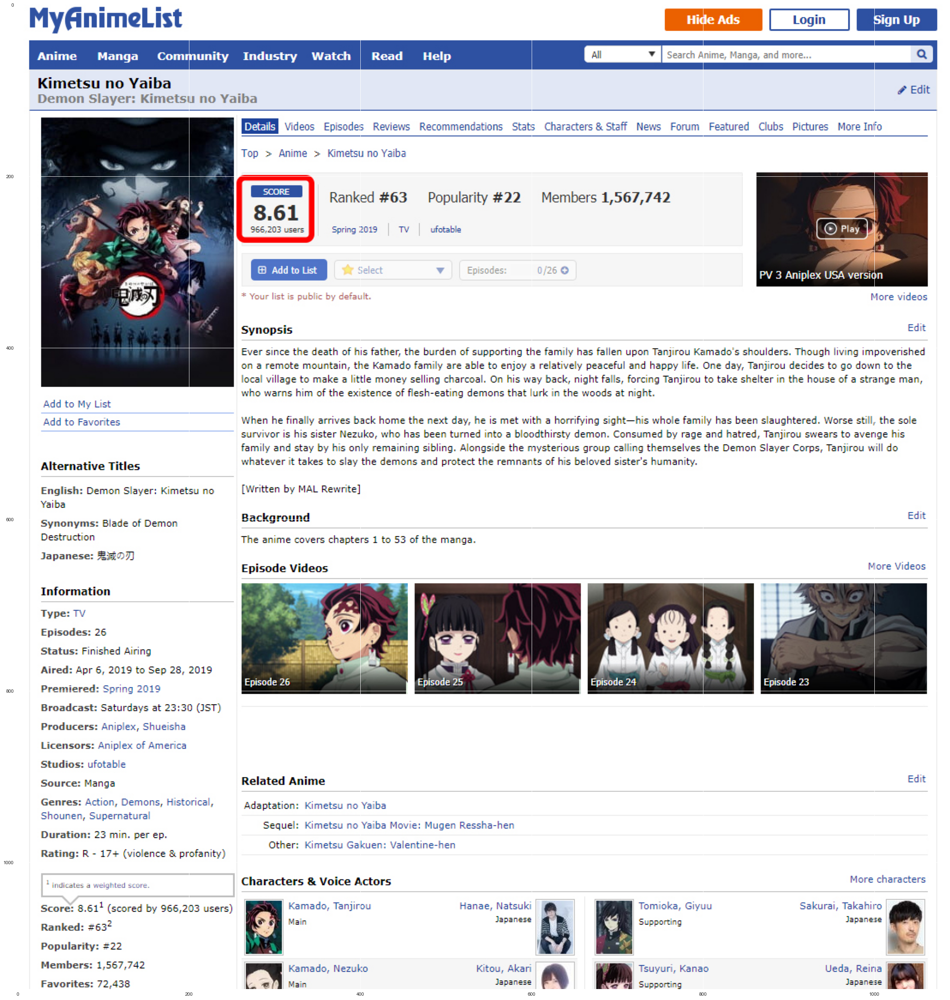

In [44]:
demon_slayer = [[5,6,26,4,966203,63,22,1567326,72436,23.0,2019]]

anime_predict_score(demon_slayer)

### running anime Dororo's information through my model

Dororo's predicted anime score (using Linear Regression) is: [8.51063457]
Dororo's predicted anime score (using Ridge Regression) is: [8.52627244]
Dororo's predicted anime score (using Lasso Regression) is: [8.53905868]
Dororo's predicted anime score (using Elastic Net Regression) is: [8.53935827]
Dororo's predicted anime score (using Polynomial Regression) is: [8.21881865]
Dororo's predicted anime score (using Support Vector Machine for Regression) is: [8.12484967]
Dororo's predicted anime score (using Gradient Boosting Regression) is: [8.19505827]
Dororo's predicted anime score (using Extra Trees Regression) is: [8.19205]
Dororo's predicted anime score (using Random Forest Regression) is: [8.1901]


Screenshot taken from myAnimelist.com of the actual score


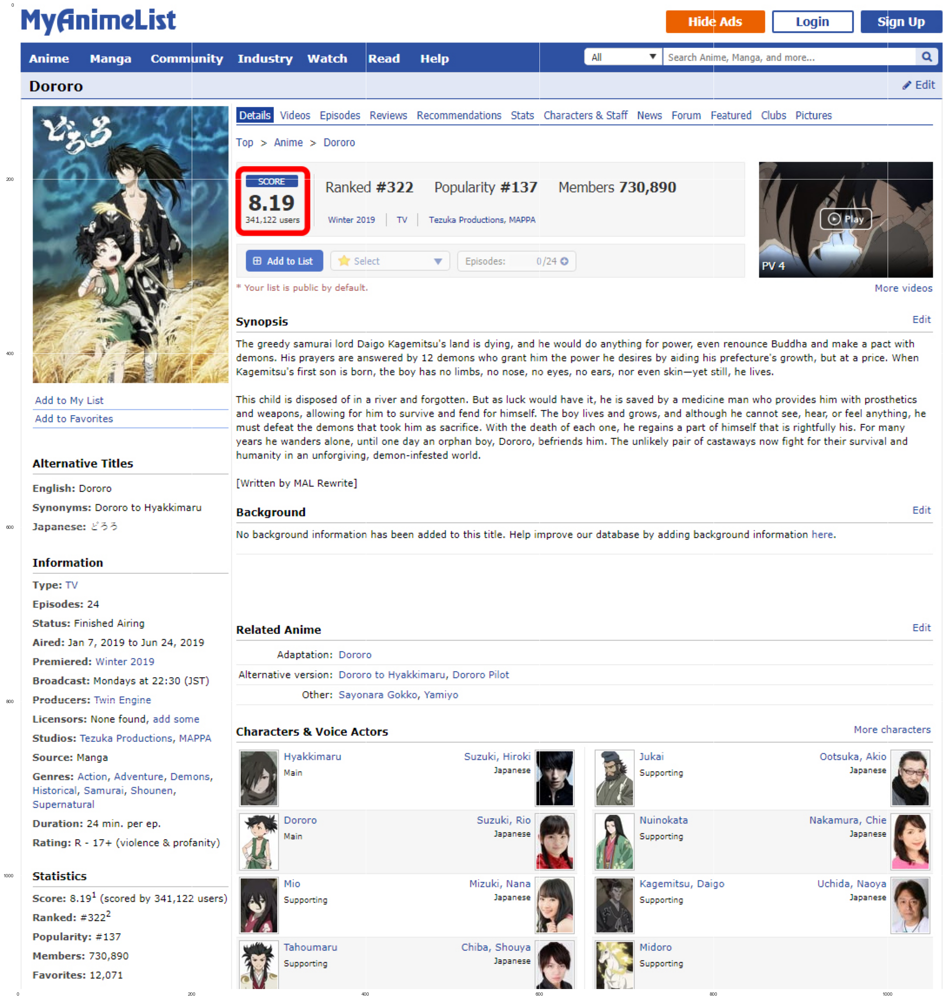

In [45]:
dororo = [[5,6,24,4,341122,322,137,730890,12071,24.0,2019]]

anime_predict_score(dororo)

### running anime Attack on Titan: Season 3's information through my model

Attack On Titan Season 3's predicted anime score (using Linear Regression) is: [8.46352116]
Attack On Titan Season 3's predicted anime score (using Ridge Regression) is: [8.46640008]
Attack On Titan Season 3's predicted anime score (using Lasso Regression) is: [8.47722362]
Attack On Titan Season 3's predicted anime score (using Elastic Net Regression) is: [8.47498642]
Attack On Titan Season 3's predicted anime score (using Polynomial Regression) is: [8.62271278]
Attack On Titan Season 3's predicted anime score (using Support Vector Machine for Regression) is: [7.76941131]
Attack On Titan Season 3's predicted anime score (using Gradient Boosting Regression) is: [8.61333427]
Attack On Titan Season 3's predicted anime score (using Extra Trees Regression) is: [8.6296]
Attack On Titan Season 3's predicted anime score (using Random Forest Regression) is: [8.6322]


Screenshot taken from myAnimelist.com of the actual score


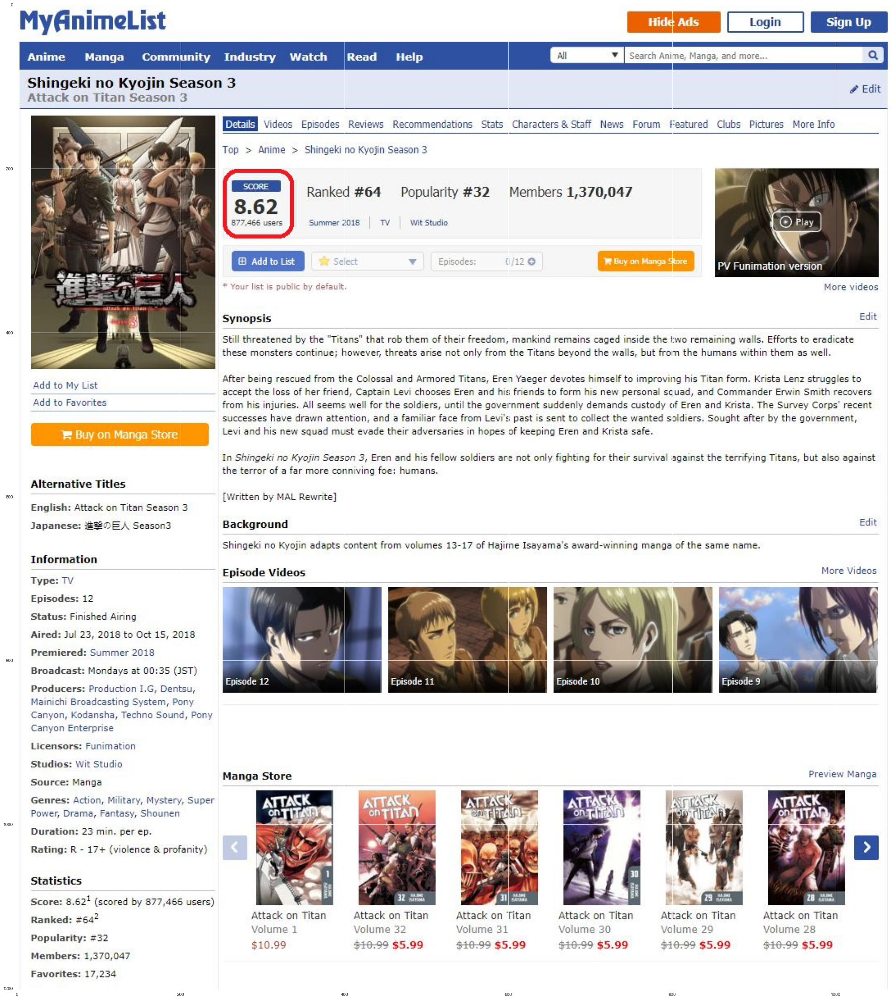

In [46]:
Attack_on_Titan_season_3 = [[5,6,12,4,877466,64,32,1370047,17234,23.0,2018]]

anime_predict_score(Attack_on_Titan_season_3)

### running anime My Hero Academia: Season 3's information through my model

In [47]:
my_hero_season_3 = [[5,6,25,3,916942,294,30,1452482,14255,23.0,2018]]

anime_predict_score(my_hero_season_3)

My Hero Season 3's predicted anime score (using Linear Regression) is: [8.45110939]
My Hero Season 3's predicted anime score (using Ridge Regression) is: [8.45385158]
My Hero Season 3's predicted anime score (using Lasso Regression) is: [8.46245661]
My Hero Season 3's predicted anime score (using Elastic Net Regression) is: [8.46108584]
My Hero Season 3's predicted anime score (using Polynomial Regression) is: [8.21580291]
My Hero Season 3's predicted anime score (using Support Vector Machine for Regression) is: [7.21988615]
My Hero Season 3's predicted anime score (using Gradient Boosting Regression) is: [8.21476007]
My Hero Season 3's predicted anime score (using Extra Trees Regression) is: [8.2181]
My Hero Season 3's predicted anime score (using Random Forest Regression) is: [8.21995]


Screenshot taken from myAnimelist.com of the actual score


### running anime Jujutsu Kaisen's information through my model

Jujutsu Kaisen's predicted anime score (using Linear Regression) is: [9.03151218]
Jujutsu Kaisen's predicted anime score (using Ridge Regression) is: [9.05049886]
Jujutsu Kaisen's predicted anime score (using Lasso Regression) is: [9.0662274]
Jujutsu Kaisen's predicted anime score (using Elastic Net Regression) is: [9.06647776]
Jujutsu Kaisen's predicted anime score (using Polynomial Regression) is: [8.83726951]
Jujutsu Kaisen's predicted anime score (using Support Vector Machine for Regression) is: [9.70393172]
Jujutsu Kaisen's predicted anime score (using Gradient Boosting Regression) is: [8.83869741]
Jujutsu Kaisen's predicted anime score (using Extra Trees Regression) is: [8.8269]
Jujutsu Kaisen's predicted anime score (using Random Forest Regression) is: [8.8429]


Screenshot taken from myAnimelist.com of the actual score


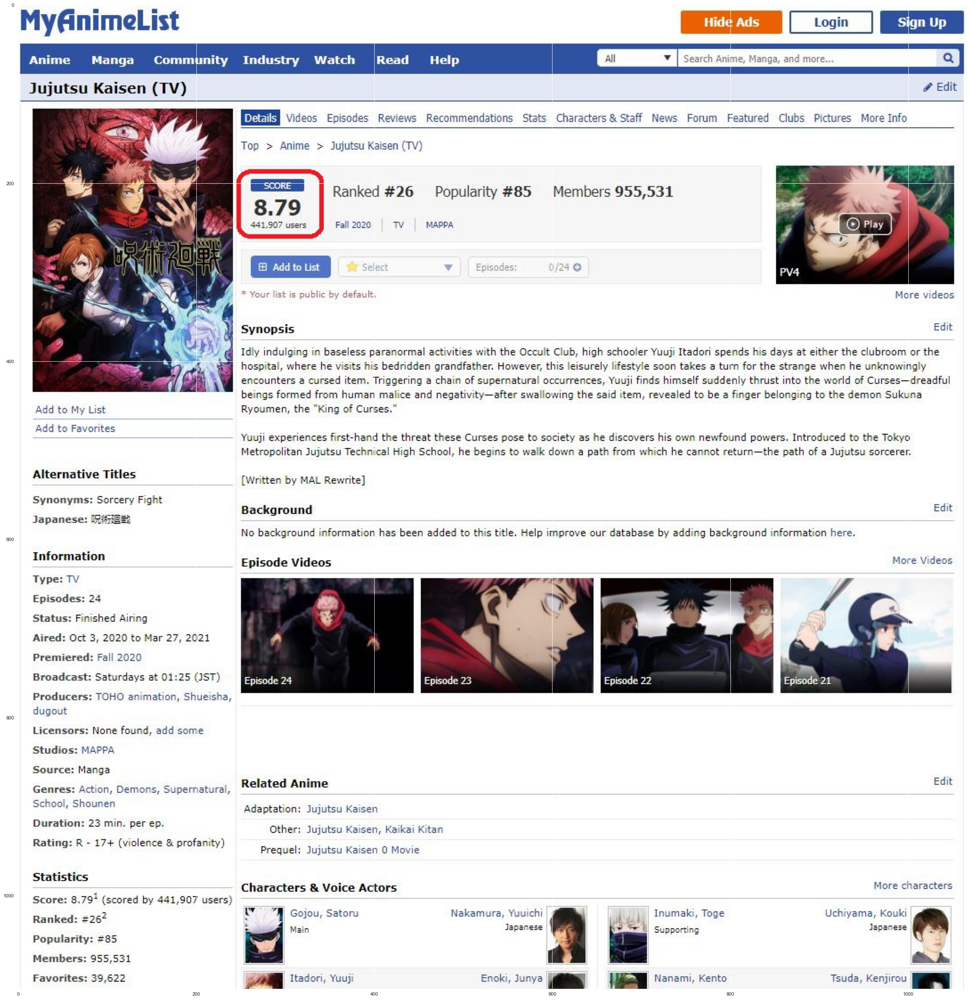

In [48]:
jujutsu_kaisen = [[5,6,24,4,441907,26,85,955531,39622,23.0,2020]]

anime_predict_score(jujutsu_kaisen)

### running anime Mob Psycho 100: Season 2's information through my model

Mob Psycho 100 Season 2's predicted anime score (using Linear Regression) is: [8.47365441]
Mob Psycho 100 Season 2's predicted anime score (using Ridge Regression) is: [8.47442491]
Mob Psycho 100 Season 2's predicted anime score (using Lasso Regression) is: [8.49347738]
Mob Psycho 100 Season 2's predicted anime score (using Elastic Net Regression) is: [8.49180144]
Mob Psycho 100 Season 2's predicted anime score (using Polynomial Regression) is: [8.8761218]
Mob Psycho 100 Season 2's predicted anime score (using Support Vector Machine for Regression) is: [8.21474918]
Mob Psycho 100 Season 2's predicted anime score (using Gradient Boosting Regression) is: [8.86896958]
Mob Psycho 100 Season 2's predicted anime score (using Extra Trees Regression) is: [8.8836]
Mob Psycho 100 Season 2's predicted anime score (using Random Forest Regression) is: [8.89505]


Screenshot taken from myAnimelist.com of the actual score


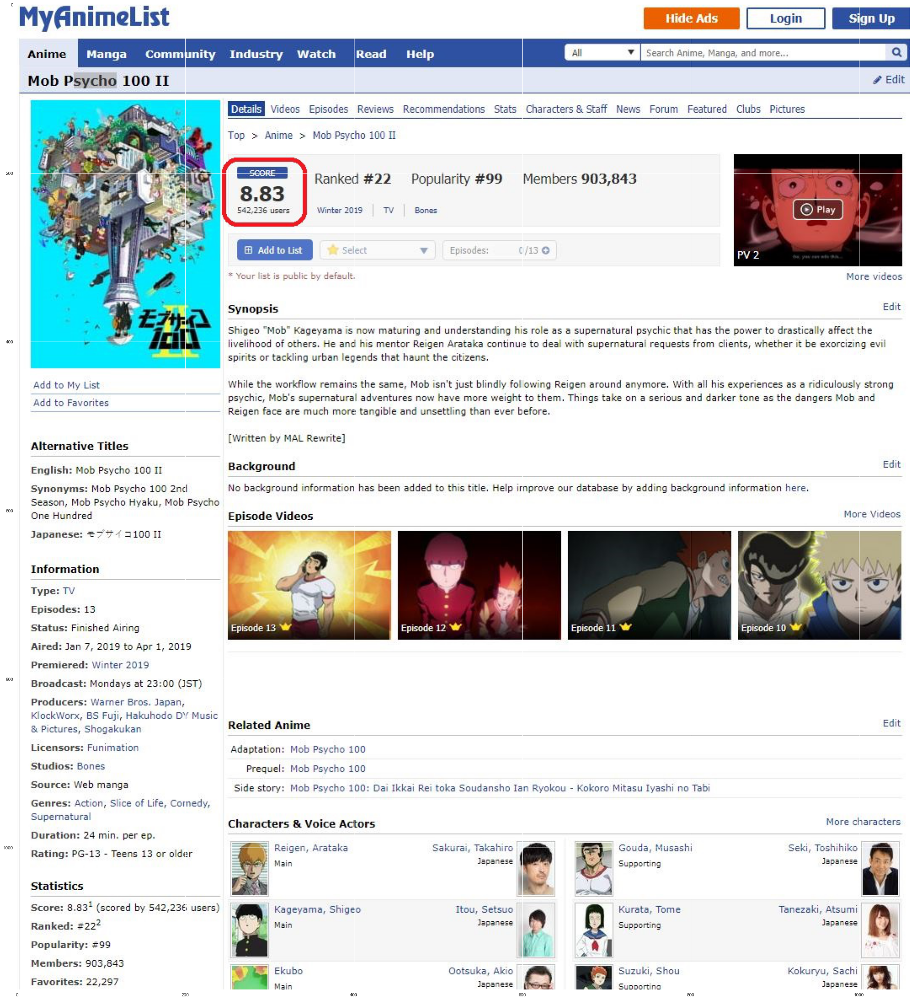

In [49]:
mob_psycho_100_season_2 = [[5,14,13,3,542236,22,99,903843,22297,24.0,2019]]

anime_predict_score(mob_psycho_100_season_2)